In [358]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import pandas as pd
import requests
import time

# add geometry data
import pandas as pd
from census import Census
from us import states
import requests
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import shape

import requests
import geopandas as gpd
import pandas as pd
from shapely.geometry import shape
from concurrent.futures import ThreadPoolExecutor

In [2]:
# ! pip install umap-learn


# Load the clean data with the columns cleaned. If more columns need cleaning, go to the pca notebook and clean them there.

In [300]:
# df_clean = pd.read_csv('../../data/tidy/2023_Crashes_CT_MA_cleaned.csv', low_memory=False)
# unique_tracts_df = pd.read_csv('../../data/tidy/2023_Crashes_CT_MA_cleaned_tracts.csv', low_memory=False)

# # convert to parquet and save
# df_clean.to_parquet('../../data/tidy/2023_Crashes_CT_MA_cleaned.parquet')
# unique_tracts_df.to_parquet('../../data/tidy/2023_Crashes_CT_MA_cleaned_tracts.parquet')

# unique_tracts_df

,census_tract_id,census_tract_geometry
0,9140405402,"POLYGON ((-72.92281300024155 41.6685640001348,..."
1,9140405801,"POLYGON ((-72.95926999956018 41.7166819998621,..."
2,9190211000,POLYGON ((-73.51427999969337 41.44563599974592...
3,9170180300,POLYGON ((-72.87181299961684 41.27880299968149...
4,9120061500,POLYGON ((-73.25020800034699 41.14764799976098...
...,...,...
2475,25025000302,POLYGON ((-71.17479800023261 42.35026500019437...
2476,25025070600,POLYGON ((-71.07593600022187 42.34391500028469...
2477,25025000603,POLYGON ((-71.15036399967605 42.34896999987538...
2478,25025110106,POLYGON ((-71.11925900022513 42.29048600003167...


In [359]:
from shapely import wkt

# load it
# df_clean = pd.read_csv('../../data/tidy/2023_Crashes_CT_MA_cleaned.csv', low_memory=False)
# unique_tracts_df = pd.read_csv('../../data/tidy/2023_Crashes_CT_MA_cleaned_tracts.csv', low_memory=False)
# load as parquet
df_clean = pd.read_parquet('../../data/tidy/2023_Crashes_CT_MA_cleaned.parquet')
unique_tracts_df = pd.read_parquet('../../data/tidy/2023_Crashes_CT_MA_cleaned_tracts.parquet')

# Convert the geometry column from WKT format to Shapely geometric objects
unique_tracts_df['census_tract_geometry'] = unique_tracts_df['census_tract_geometry'].apply(wkt.loads)
unique_tracts_df


,census_tract_id,census_tract_geometry
0,9140405402,"POLYGON ((-72.92281300024155 41.6685640001348,..."
1,9140405801,"POLYGON ((-72.95926999956018 41.7166819998621,..."
2,9190211000,POLYGON ((-73.51427999969337 41.44563599974592...
3,9170180300,POLYGON ((-72.87181299961684 41.27880299968149...
4,9120061500,POLYGON ((-73.25020800034699 41.14764799976098...
...,...,...
2475,25025000302,POLYGON ((-71.17479800023261 42.35026500019437...
2476,25025070600,POLYGON ((-71.07593600022187 42.34391500028469...
2477,25025000603,POLYGON ((-71.15036399967605 42.34896999987538...
2478,25025110106,POLYGON ((-71.11925900022513 42.29048600003167...


In [360]:

# add unigue tracts df with urban_area_name	and	county_name
unique_tracts_county_urban_df = df_clean[['census_tract_id', 'urban_area_name', 'county_name']].dropna()
unique_tracts_county_urban_df = unique_tracts_county_urban_df.drop_duplicates()
# save it
unique_tracts_county_urban_df.to_csv('../../data/tidy/2023_Crashes_CT_MA_cleaned_tracts_county_urban.csv', index=False)
unique_tracts_county_urban_df

,census_tract_id,urban_area_name,county_name
0,25021402101,"Boston, MA--NH Urban Area",Norfolk County
3,25017317202,"Boston, MA--NH Urban Area",Middlesex County
5,25017317101,"Boston, MA--NH Urban Area",Middlesex County
6,25023510900,"Boston, MA--NH Urban Area",Plymouth County
10,25017334200,"Boston, MA--NH Urban Area",Middlesex County
...,...,...,...
435975,9160290100,"Winsted, CT Urban Area",Northwest Hills Planning Region
447477,9140362102,"Waterbury, CT Urban Area",Naugatuck Valley Planning Region
462521,9130590102,"Hartford, CT Urban Area",Lower Connecticut River Valley Planning Region
466466,9140341100,"Bridgeport--Stamford, CT--NY Urban Area",Naugatuck Valley Planning Region


In [303]:

# turn Hour into categorical by time of day
df_clean['hour'] = pd.cut(df_clean['hour'], bins=[0, 6, 12, 18, 24], labels=['Night', 'Morning', 'Afternoon', 'Evening'])
df_clean

,crash_id,latitude,longitude,city/town,crash_severity,most_injury,injury_status,first_harm,most_harm,crash_manner,...,urban_area_name,county_subdiv,county_name,county_id,census_block_name,census_block_id,date,time,hour,day_of_week
0,MA5195046,42.255410,-71.164260,DEDHAM,Property Damage Only,No Apparent Injury (O),No Injury,Collision with motor vehicle in traffic,V1:(Collision with motor vehicle in traffic) /...,Rear-end,...,"Boston, MA--NH Urban Area",Dedham town,Norfolk County,25021.0,Block 3012,2.502140e+14,2023-01-01,01:15:00,Night,7.0
1,MA5195046,42.255410,-71.164260,DEDHAM,Property Damage Only,No Apparent Injury (O),No Injury,Collision with motor vehicle in traffic,V1:(Collision with motor vehicle in traffic) /...,Rear-end,...,"Boston, MA--NH Urban Area",Dedham town,Norfolk County,25021.0,Block 3012,2.502140e+14,2023-01-01,01:15:00,Night,7.0
2,MA5195046,42.255410,-71.164260,DEDHAM,Property Damage Only,No Apparent Injury (O),No Injury,Collision with motor vehicle in traffic,V1:(Collision with motor vehicle in traffic) /...,Rear-end,...,"Boston, MA--NH Urban Area",Dedham town,Norfolk County,25021.0,Block 3012,2.502140e+14,2023-01-01,01:15:00,Night,7.0
3,MA5196046,42.602477,-71.356661,CHELMSFORD,Fatal,Fatal injury (K),Unknown,Collision with motor vehicle in traffic,V1:(Collision with motor vehicle in traffic) /...,Head-on,...,"Boston, MA--NH Urban Area",Chelmsford town,Middlesex County,25017.0,Block 1013,2.501732e+14,2023-01-01,13:18:00,Afternoon,7.0
4,MA5196046,42.602477,-71.356661,CHELMSFORD,Fatal,Fatal injury (K),Unknown,Collision with motor vehicle in traffic,V1:(Collision with motor vehicle in traffic) /...,Head-on,...,"Boston, MA--NH Urban Area",Chelmsford town,Middlesex County,25017.0,Block 1013,2.501732e+14,2023-01-01,13:18:00,Afternoon,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
487856,CT1172762,41.476464,-72.264773,Salem,Property Damage Only,No Apparent Injury (O),No Injury,14,22.0,1,...,None,Salem town,Southeastern Connecticut Planning Region,9180.0,Block 3016,9.011715e+13,2023-06-28,12:55:00,Morning,3.0
487857,CT1172762,41.476464,-72.264773,Salem,Property Damage Only,No Apparent Injury (O),No Injury,14,22.0,1,...,None,Salem town,Southeastern Connecticut Planning Region,9180.0,Block 3016,9.011715e+13,2023-06-28,12:55:00,Morning,3.0
487858,CT1172763,41.597041,-72.903030,Southington,Fatal,Fatal Injury (K),No Injury,9,17.0,88,...,"Hartford, CT Urban Area",Southington town,Capitol Planning Region,9110.0,Block 1024,9.003431e+13,2023-10-03,01:46:00,Night,2.0
487859,CT1173303,41.764959,-72.553294,Manchester,"Injury of any type (Serious, Minor, Possible)",Suspected Serious Injury (A),Minor Injury,32,40.0,88,...,"Hartford, CT Urban Area",Manchester town,Capitol Planning Region,9110.0,Block 2002,9.003515e+13,2023-07-04,13:16:00,Afternoon,2.0


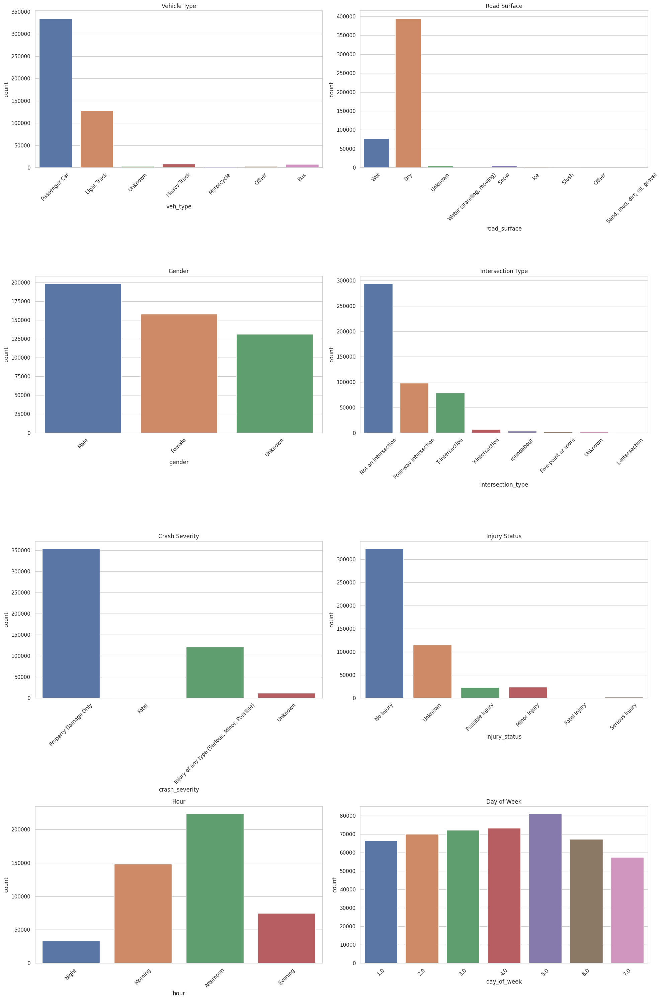

In [304]:
# plot the frequency of each column from the above 
fig, ax = plt.subplots(4, 2, figsize=(20, 30))
# plot frequency of vehicle type
sns.countplot(data=df_clean, x='veh_type', ax=ax[0, 0])
ax[0, 0].set_title('Vehicle Type')
# plot frequency of road surface
sns.countplot(data=df_clean, x='road_surface', ax=ax[0, 1])
ax[0, 1].set_title('Road Surface')
# plot frequency of gender
sns.countplot(data=df_clean, x = 'gender', ax=ax[1, 0])
ax[1, 0].set_title('Gender')

# plot frequency of intersection type
sns.countplot(data=df_clean, x='intersection_type', ax=ax[1, 1])
ax[1,1].set_title('Intersection Type')
# plot frequency of crash severity
sns.countplot(data=df_clean, x='crash_severity', ax=ax[2,0])
ax[2, 0].set_title('Crash Severity')

# plot frequency of injury status
sns.countplot(data=df_clean, x='injury_status', ax=ax[2, 1])
ax[2, 1].set_title('Injury Status')

# plot frequency of light condition
sns.countplot(data=df_clean, x='hour', ax=ax[3, 0])
ax[3, 0].set_title('Hour')

# plot frequency of weather condition
sns.countplot(data=df_clean, x='day_of_week', ax=ax[3, 1])
ax[3, 1].set_title('Day of Week')

# all 45 degree rotation
ax[0, 0].tick_params(axis='x', rotation=45)
ax[0, 1].tick_params(axis='x', rotation=45)
ax[1, 0].tick_params(axis='x', rotation=45)
ax[1, 1].tick_params(axis='x', rotation=45)
ax[2, 0].tick_params(axis='x', rotation=45)
ax[2, 1].tick_params(axis='x', rotation=45)
ax[3, 0].tick_params(axis='x', rotation=45)
ax[3, 1].tick_params(axis='x', rotation=45)


plt.tight_layout()
plt.show()


In [305]:
# df_clean.csa_pop.unique()

# With census tract data

#### Aggregate the data

In [306]:
# import tqdm
from tqdm import tqdm
crash_data = df_clean.copy()
def aggregate_categorical(data, column):
    return data[column].value_counts(normalize=True).to_dict()

def aggregate_numerical(data, column):
    return {
        'mean': data[column].mean(),
        'std': data[column].std(),
    }
def aggregate_data(data):
    grouped = data.groupby('census_tract_id')
    
    # Initialize a list to store aggregated data
    aggregated_data = []

    for name, group in tqdm(grouped):
        aggregated = {'census_tract_id': name}
        
        # Aggregate categorical columns
        categorical_columns = ['crash_severity',
                                'injury_status',
                                'road_surface',
                                'intersection_type',
                                'veh_type',
                                'hour', 'day_of_week'
                                ]
        for col in categorical_columns:
            aggregated.update({f"{col}_{k}": v for k, v in aggregate_categorical(group, col).items()})
        
        # Aggregate numerical columns
        numerical_columns = ['speed_lim', 'age', 'n_veh', 'n_occupants',]
        for col in numerical_columns:
            aggregated.update({f"{col}_{k}": v for k, v in aggregate_numerical(group, col).items()})
        
        aggregated_data.append(aggregated)
    
    return pd.DataFrame(aggregated_data)



# Aggregate the data
aggregated_data = aggregate_data(crash_data)
# Fill NaNs in categorical proportions with 0
categorical_columns = [col for col in aggregated_data.columns if '_id' not in col and '_mean' not in col and '_std' not in col and '_median' not in col and '_min' not in col and '_max' not in col and '_sum' not in col]
# Fill NaNs in numerical summaries with 0
numerical_columns = [col for col in aggregated_data.columns if col not in categorical_columns and '_id' not in col]

aggregated_data[categorical_columns] = aggregated_data[categorical_columns].fillna(0)
aggregated_data[numerical_columns] = aggregated_data[numerical_columns].fillna(0)

# Standardize numerical features
scaler = StandardScaler()
aggregated_data[numerical_columns] = scaler.fit_transform(aggregated_data[numerical_columns])


aggregated_data = pd.merge(aggregated_data, unique_tracts_df, on='census_tract_id', how='left')
# use unique_tracts_df to add the geometry
gdf = gpd.GeoDataFrame(aggregated_data, geometry='census_tract_geometry')
# drop the geometry column
aggregated_data = aggregated_data.drop(columns=['census_tract_geometry'], errors='ignore')
aggregated_data

 15%|█▌        | 380/2480 [00:01<00:06, 307.76it/s]

100%|██████████| 2480/2480 [00:08<00:00, 303.76it/s]


,census_tract_id,crash_severity_Property Damage Only,"crash_severity_Injury of any type (Serious, Minor, Possible)",crash_severity_Fatal,injury_status_No Injury,injury_status_Possible Injury,injury_status_Minor Injury,injury_status_Unknown,injury_status_Serious Injury,injury_status_Fatal Injury,...,"road_surface_Sand, mud, dirt, oil, gravel",intersection_type_Five-point or more,intersection_type_Y-intersection,road_surface_Slush,intersection_type_Unknown,road_surface_Unknown,intersection_type_roundabout,"road_surface_Water (standing, moving)",road_surface_Other,crash_severity_Unknown
0,9110400101,0.725038,0.271889,0.003072,0.855607,0.090630,0.041475,0.006144,0.004608,0.001536,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000
1,9110400102,0.766478,0.225989,0.007533,0.841808,0.082863,0.052731,0.016949,0.001883,0.003766,...,0.009416,0.030132,0.007533,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000
2,9110400200,0.467890,0.525994,0.006116,0.697248,0.186544,0.100917,0.009174,0.003058,0.003058,...,0.000000,0.000000,0.051988,0.009174,0.000000,0.000000,0.0,0.000000,0.0,0.000000
3,9110400300,0.679842,0.320158,0.000000,0.766798,0.130435,0.067194,0.027668,0.007905,0.000000,...,0.000000,0.000000,0.035573,0.007905,0.007905,0.000000,0.0,0.000000,0.0,0.000000
4,9110415300,0.610526,0.389474,0.000000,0.747368,0.084211,0.126316,0.042105,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.042105,0.0,0.000000,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2475,25027761401,0.777174,0.195652,0.000000,0.228261,0.010870,0.016304,0.739130,0.005435,0.000000,...,0.000000,0.010870,0.005435,0.005435,0.000000,0.005435,0.0,0.005435,0.0,0.027174
2476,25027761402,0.763359,0.213740,0.000000,0.244275,0.000000,0.015267,0.740458,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.030534,0.000000,0.0,0.000000,0.0,0.022901
2477,44005041701,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000
2478,44005041702,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,1.000000


In [307]:
# remove all columns that include the word 'unknown'
# unknown_cols = [col for col in aggregated_data.columns if 'unknown' in col]
# in unknown is part of any column that is set to lower case
unknown_cols = [col for col in aggregated_data.columns if 'unknown' in col.lower()]
aggregated_data = aggregated_data.drop(columns=unknown_cols, errors='ignore')
aggregated_data

,census_tract_id,crash_severity_Property Damage Only,"crash_severity_Injury of any type (Serious, Minor, Possible)",crash_severity_Fatal,injury_status_No Injury,injury_status_Possible Injury,injury_status_Minor Injury,injury_status_Serious Injury,injury_status_Fatal Injury,road_surface_Dry,...,n_veh_std,n_occupants_mean,n_occupants_std,"road_surface_Sand, mud, dirt, oil, gravel",intersection_type_Five-point or more,intersection_type_Y-intersection,road_surface_Slush,intersection_type_roundabout,"road_surface_Water (standing, moving)",road_surface_Other
0,9110400101,0.725038,0.271889,0.003072,0.855607,0.090630,0.041475,0.004608,0.001536,0.846390,...,-0.335980,0.019149,-0.219714,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0
1,9110400102,0.766478,0.225989,0.007533,0.841808,0.082863,0.052731,0.001883,0.003766,0.830508,...,0.634029,-0.027627,1.160269,0.009416,0.030132,0.007533,0.000000,0.0,0.000000,0.0
2,9110400200,0.467890,0.525994,0.006116,0.697248,0.186544,0.100917,0.003058,0.003058,0.700306,...,0.189897,0.289939,0.263104,0.000000,0.000000,0.051988,0.009174,0.0,0.000000,0.0
3,9110400300,0.679842,0.320158,0.000000,0.766798,0.130435,0.067194,0.007905,0.000000,0.747036,...,-0.020476,3.177296,3.476088,0.000000,0.000000,0.035573,0.007905,0.0,0.000000,0.0
4,9110415300,0.610526,0.389474,0.000000,0.747368,0.084211,0.126316,0.000000,0.000000,0.736842,...,-0.910461,0.193218,-0.145047,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2475,25027761401,0.777174,0.195652,0.000000,0.228261,0.010870,0.016304,0.005435,0.000000,0.755435,...,2.476312,-0.338739,-0.179087,0.000000,0.010870,0.005435,0.005435,0.0,0.005435,0.0
2476,25027761402,0.763359,0.213740,0.000000,0.244275,0.000000,0.015267,0.000000,0.000000,0.793893,...,1.807152,-0.409698,-0.439043,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0
2477,44005041701,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,...,-2.698407,-0.625313,-0.681914,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0
2478,44005041702,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,...,-2.698407,-0.625313,-0.681914,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0


Starting to plot


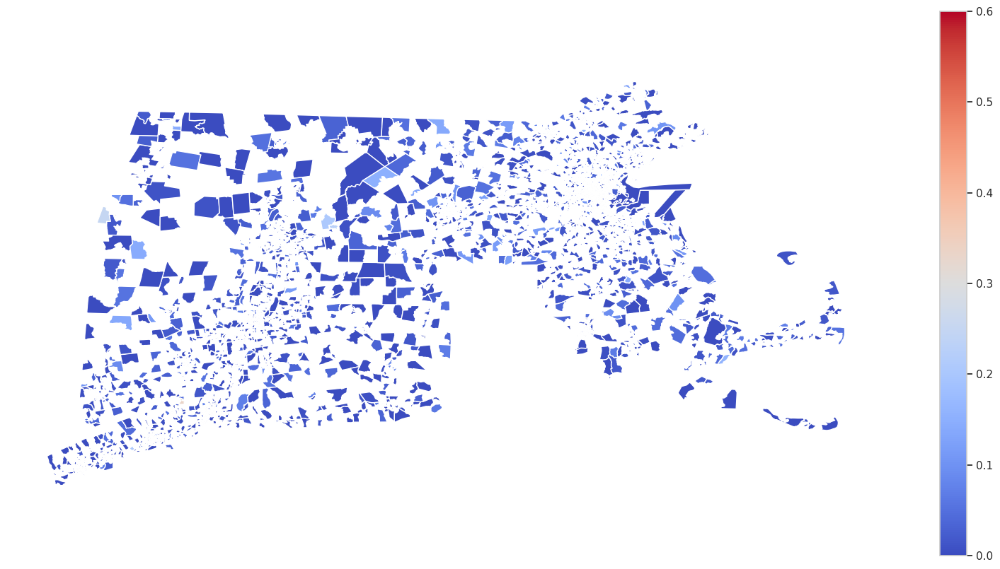

In [308]:
# print
print('Starting to plot')
gdf.plot(
        column='intersection_type_Y-intersection',
        cmap='coolwarm',
        figsize=(20, 10), 
        # min
        vmin=0,
        legend=True)
# remove axis
plt.axis('off')

plt.show()

### Apply UMAP

%%%%%%%%%%%%%%%%%%%%%%%

In [309]:
import numpy as np
import pandas as pd
import umap
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.model_selection import ParameterGrid
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm


data = aggregated_data.copy()
# Inspect the data
display(data.head())
# display(data.info())
# Drop rows with missing values
data_cleaned = data.dropna()
# Select relevant features
features = [col for col in data_cleaned.columns if 'census_tract_id' not in col and 'geometry' not in col]
X = data_cleaned[features].values
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)


,census_tract_id,crash_severity_Property Damage Only,"crash_severity_Injury of any type (Serious, Minor, Possible)",crash_severity_Fatal,injury_status_No Injury,injury_status_Possible Injury,injury_status_Minor Injury,injury_status_Serious Injury,injury_status_Fatal Injury,road_surface_Dry,...,n_veh_std,n_occupants_mean,n_occupants_std,"road_surface_Sand, mud, dirt, oil, gravel",intersection_type_Five-point or more,intersection_type_Y-intersection,road_surface_Slush,intersection_type_roundabout,"road_surface_Water (standing, moving)",road_surface_Other
0,9110400101,0.725038,0.271889,0.003072,0.855607,0.090630,0.041475,0.004608,0.001536,0.846390,...,-0.335980,0.019149,-0.219714,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
1,9110400102,0.766478,0.225989,0.007533,0.841808,0.082863,0.052731,0.001883,0.003766,0.830508,...,0.634029,-0.027627,1.160269,0.009416,0.030132,0.007533,0.000000,0.0,0.0,0.0
2,9110400200,0.467890,0.525994,0.006116,0.697248,0.186544,0.100917,0.003058,0.003058,0.700306,...,0.189897,0.289939,0.263104,0.000000,0.000000,0.051988,0.009174,0.0,0.0,0.0
3,9110400300,0.679842,0.320158,0.000000,0.766798,0.130435,0.067194,0.007905,0.000000,0.747036,...,-0.020476,3.177296,3.476088,0.000000,0.000000,0.035573,0.007905,0.0,0.0,0.0
4,9110415300,0.610526,0.389474,0.000000,0.747368,0.084211,0.126316,0.000000,0.000000,0.736842,...,-0.910461,0.193218,-0.145047,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0


A correlation matrix heatmap can provide a comprehensive view of the relationships between all features without plotting every pairwise combination.

Number of columns: 48
Number of columns: 48


/tmp/ipykernel_3701303/1067842781.py:22: FutureWarning:

The default value of regex will change from True to False in a future version.

/tmp/ipykernel_3701303/1067842781.py:22: FutureWarning:

The default value of regex will change from True to False in a future version.

/tmp/ipykernel_3701303/1067842781.py:23: FutureWarning:

The default value of regex will change from True to False in a future version.

/tmp/ipykernel_3701303/1067842781.py:23: FutureWarning:

The default value of regex will change from True to False in a future version.



,Age Mean,Age Std,Fatal,Injury Of Any Type,Property Damage Only,Day Of Week 1,Day Of Week 2,Day Of Week 3,Day Of Week 4,Day Of Week 5,...,Road Surface Water (),Road Surface Wet,Speed Lim Mean,Speed Lim Std,Bus,Heavy Truck,Light Truck,Motorcycle,Other,Passenger Car
Age Mean,1.000000,0.464006,-0.038243,-0.134867,0.141742,-0.019098,0.093216,0.052736,-0.010103,-0.012133,...,-0.017103,-0.063991,0.014429,0.012556,-0.131020,0.059479,-0.057416,0.074725,0.012513,0.066474
Age Std,0.464006,1.000000,-0.136828,-0.132567,0.247160,0.000791,0.117526,0.042328,-0.059484,0.067053,...,0.019034,0.002762,0.089309,0.131889,0.028074,0.028370,0.025190,-0.042820,0.057008,-0.023747
Fatal,-0.038243,-0.136828,1.000000,-0.039880,-0.186972,-0.051184,-0.018142,-0.061181,-0.066704,-0.070567,...,0.002950,0.114884,0.037591,-0.038166,-0.013014,-0.001284,-0.009247,0.011864,-0.019667,0.011057
Injury Of Any Type,-0.134867,-0.132567,-0.039880,1.000000,-0.754032,0.000072,-0.034392,0.020979,-0.001464,-0.033685,...,0.022079,0.052775,0.027631,-0.034950,0.048897,-0.028392,0.072277,0.157871,0.002914,-0.086839
Property Damage Only,0.141742,0.247160,-0.186972,-0.754032,1.000000,0.013221,0.065196,0.009060,-0.055523,0.061284,...,-0.020381,-0.102254,0.068201,0.203576,0.023198,0.075575,0.113890,-0.109609,0.027383,-0.107000
Day Of Week 1,-0.019098,0.000791,-0.051184,0.000072,0.013221,1.000000,-0.187986,-0.198321,-0.170905,-0.176316,...,0.012573,-0.041473,-0.052167,-0.061677,-0.027860,-0.006191,-0.048128,-0.062649,0.002448,0.057738
Day Of Week 2,0.093216,0.117526,-0.018142,-0.034392,0.065196,-0.187986,1.000000,-0.138512,-0.143698,-0.172424,...,-0.010945,-0.051627,0.018193,-0.004723,0.009452,0.121993,-0.012187,0.004039,0.000191,-0.006378
Day Of Week 3,0.052736,0.042328,-0.061181,0.020979,0.009060,-0.198321,-0.138512,1.000000,-0.137865,-0.097218,...,-0.022763,-0.041247,0.037595,0.033119,0.068181,-0.028931,0.012884,0.201699,-0.003123,-0.042097
Day Of Week 4,-0.010103,-0.059484,-0.066704,-0.001464,-0.055523,-0.170905,-0.143698,-0.137865,1.000000,-0.153937,...,0.037115,-0.107188,0.002779,0.013085,0.020884,-0.021899,-0.013076,-0.054828,-0.012123,0.017511
Day Of Week 5,-0.012133,0.067053,-0.070567,-0.033685,0.061284,-0.176316,-0.172424,-0.097218,-0.153937,1.000000,...,0.006977,0.092821,0.048922,0.054696,0.000475,-0.020234,-0.001956,-0.051577,-0.007305,0.012229


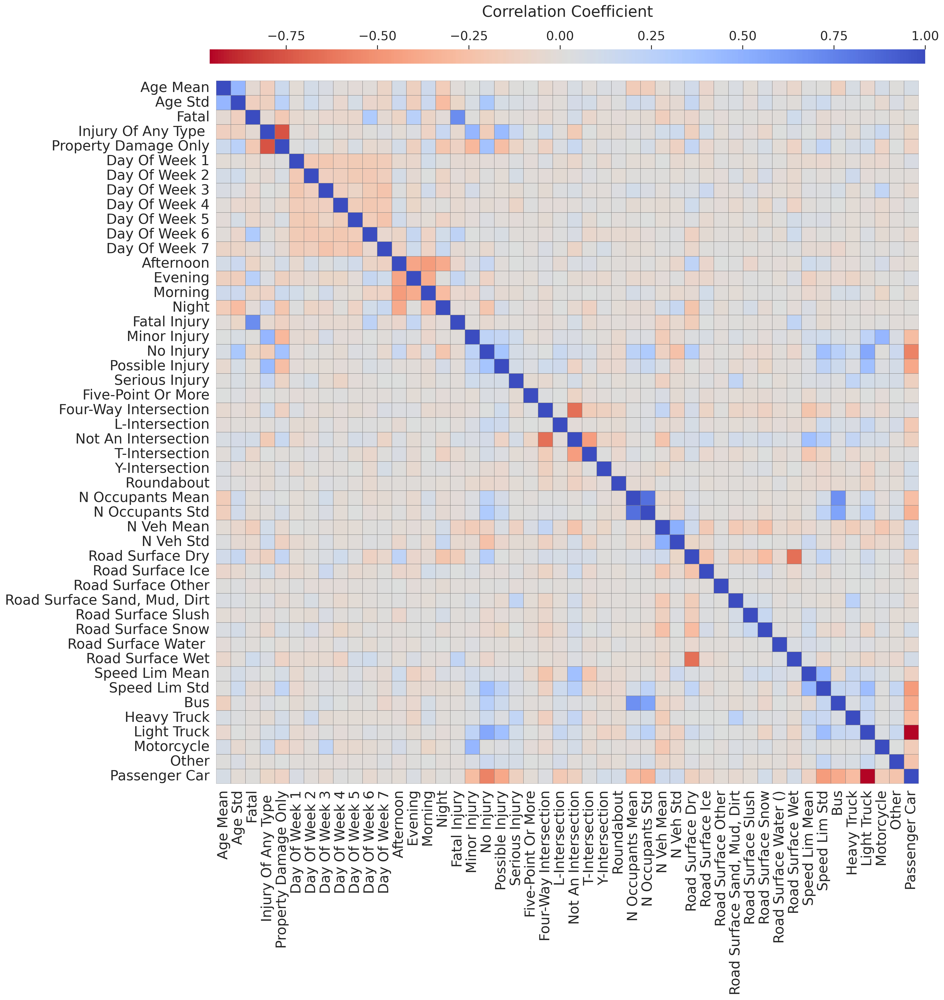

In [310]:
# Compute the correlation matrix
# sort the columns
data_cleaned = data_cleaned.sort_index(axis=1)

data_cleaned_ = data_cleaned.sort_index(axis=1).copy()
# remove census_tract_id
data_cleaned_ = data_cleaned_.drop(columns=['census_tract_id'], errors='ignore')
corr_matrix = data_cleaned_.corr()
# print number of columns
print(f'Number of columns: {len(corr_matrix.columns)}')
# remove census_tract_id from the index
corr_matrix = corr_matrix.drop(index='census_tract_id', errors='ignore')

# improve readability by remoiving the underscores of all varaibles and replacing them with spaces and making them title case
corr_matrix.columns = corr_matrix.columns.str.replace('_', ' ').str.title()
corr_matrix.index = corr_matrix.index.str.replace('_', ' ').str.title()
# remove the sentences crash_severity, injury_status, intersection_type, veh_type, hour from the column names so the remainder is the name
# corr_matrix.columns = corr_matrix.columns.str.replace('Injury Status ', '').str.replace('Intersection Type ', '').str.replace('Veh Type ', '').str.replace('Hour ', '')
# corr_matrix.index = corr_matrix.index.str.replace('Injury Status ', '').str.replace('Intersection Type ', '').str.replace('Veh Type ', '').str.replace('Hour ', '')

# remove the sentences crash_severity, injury_status, intersection_type, veh_type, hour
corr_matrix.columns = corr_matrix.columns.str.replace('Crash Severity', '').str.replace('Injury Status', '').str.replace('Intersection Type', '').str.replace('Veh Type', '').str.replace('Hour', '').str.replace('\(Serious, Minor, Possible\)', '').str.replace(', Oil, Gravel', '').str.replace('(Standing, Moving)', '')
corr_matrix.index = corr_matrix.index.str.replace('Crash Severity', '').str.replace('Injury Status', '').str.replace('Intersection Type', '').str.replace('Veh Type', '').str.replace('Hour', '').str.replace('\(Serious, Minor, Possible\)', '').str.replace(', Oil, Gravel', '').str.replace('\(Standing, Moving\)', '')
index = corr_matrix.index
# now replace the index that has Day Of Week in it and replace the .0 with ''
# create a replacement list
replacement = []
for i, ind in enumerate(index):
    if 'Day Of Week' in ind:
        replacement.append(ind.replace('.0', ''))
    else:
        replacement.append(ind)
# replace the index
corr_matrix.index = replacement


columns = corr_matrix.columns
# now replace the columns that has Day Of Week in it and replace the .0 with ''
# create a replacement list
replacement = []
for i, col in enumerate(columns):
    if 'Day Of Week' in col:
        replacement.append(col.replace('.0', ''))
    else:
        replacement.append(col)
# replace the index
corr_matrix.columns = replacement



# corr_matrix.columns = corr_matrix.columns.str.replace('Umap', 'UMAP')

# print number of columns
print(f'Number of columns: {len(corr_matrix.columns)}')
# display the correlation matrix
display(corr_matrix)
# Plot the heatmap
plt.figure(figsize=(22, 22), dpi=300)
sns.heatmap(corr_matrix, cmap='coolwarm_r', annot=False, fmt='.2f', square=True, cbar_kws={'shrink': 0.84, 'orientation': 'horizontal',
                                                                                           # put it on top
                                                                                            'location': 'top',
                                                                                            'pad': 0.02,
                                                                                            'aspect': 50
                                                                                            },
            linewidths=0.1, linecolor='grey')
# increase font size of the x and y labels
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
# increase font size of the color bar labels
cbar = plt.gcf().axes[-1]
cbar.tick_params(labelsize=18)
# now the cbar title
cbar.set_xlabel('Correlation Coefficient', fontsize=22, rotation=0, labelpad=20, )
plt.show()


In [311]:
# corr_matrix

In [312]:
data_cleaned_ = data_cleaned.sort_index(axis=1).copy()
# remove census_tract_id
data_cleaned_ = data_cleaned_.drop(columns=['census_tract_id'], errors='ignore')

# print a table of the data_cleaned info
data_cleaned_.describe()
#  remove the underscore and replace with space
data_cleaned_.columns = data_cleaned_.columns.str.replace('_', ' ').str.title()
# remove the sentences crash_severity, injury_status, intersection_type, veh_type, hour from the column names so the remainder is the name
data_cleaned_.columns = data_cleaned_.columns.str.replace('Injury Status ', '').str.replace('Intersection Type ', '').str.replace('Veh Type ', '').str.replace('Hour ', '')
# Calculate summary statistics
summary_stats = data_cleaned_.describe().T
summary_stats['median'] = data.median()
summary_stats = summary_stats[['mean', 'std', 'min', '25%', '50%', '75%', 'max']]
summary_stats.columns = ['Mean', 'Std', 'Min', '25%', 'Median', '75%', 'Max']
summary_stats = summary_stats.round(2)
summary_stats.reset_index(inplace=True)
# round each column to 2 decimal places

summary_stats

,index,Mean,Std,Min,25%,Median,75%,Max
0,Age Mean,-0.00,1.00,-6.80,-0.40,-0.00,0.43,5.09
1,Age Std,-0.00,1.00,-5.26,-0.32,0.12,0.51,5.17
2,Crash Severity Fatal,0.00,0.03,0.00,0.00,0.00,0.00,1.00
3,"Crash Severity Injury Of Any Type (Serious, Mi...",0.25,0.11,0.00,0.19,0.24,0.31,1.00
4,Crash Severity Property Damage Only,0.71,0.13,0.00,0.66,0.72,0.78,1.00
5,Day Of Week 1.0,0.14,0.08,0.00,0.10,0.13,0.17,1.00
6,Day Of Week 2.0,0.14,0.07,0.00,0.11,0.14,0.18,1.00
7,Day Of Week 3.0,0.15,0.07,0.00,0.11,0.14,0.18,1.00
8,Day Of Week 4.0,0.15,0.07,0.00,0.11,0.14,0.18,1.00
9,Day Of Week 5.0,0.16,0.07,0.00,0.12,0.16,0.20,1.00


In [313]:
import numpy as np
import pandas as pd
import umap
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.model_selection import ParameterGrid
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import joblib
from sklearn.model_selection import ParameterGrid
import random
# import GaussianMixture
from sklearn.mixture import GaussianMixture
# Set a global seed for reproducibility
np.random.seed(42)
random.seed(42)

# Define the parameter grid
param_grid = {
    'n_neighbors': [5, 10, 15, 20],
    'min_dist': [0.1, 0.3, 0.5, 1.0],
    'metric': ['euclidean', 'manhattan'],
    'n_components': [2, 3, 4, 5, 6]
}

# Create a list to store the results
param_list = list(ParameterGrid(param_grid))
total_iterations = len(param_list)

# Precompute the UMAP embeddings (single-threaded for reproducibility)
def compute_umap(params):
    n_neighbors = params['n_neighbors']
    min_dist = params['min_dist']
    metric = params['metric']
    n_components = params['n_components']
    
    reducer = umap.UMAP(n_neighbors=n_neighbors, min_dist=min_dist, metric=metric, n_components=n_components, random_state=0, n_jobs=1)
    embedding = reducer.fit_transform(X_scaled)
    return embedding

# Store UMAP embeddings for each parameter set
umap_embeddings = joblib.Parallel(n_jobs=-1)(
    joblib.delayed(compute_umap)(params) for params in tqdm(param_list, total=total_iterations)
)

# Evaluate clustering using precomputed UMAP embeddings
def evaluate_gmm(embedding):
    gmm = GaussianMixture(n_components=4, random_state=0)
    labels = gmm.fit_predict(embedding)
    score = silhouette_score(X_scaled, labels)
    return score

# Perform parallel evaluation of GMM clustering
results = joblib.Parallel(n_jobs=1)(
    joblib.delayed(evaluate_gmm)(embedding) for embedding in tqdm(umap_embeddings, total=total_iterations)
)

# Combine parameters with results
combined_results = list(zip(param_list, results))

# Find the best parameters
best_params, best_score = max(combined_results, key=lambda x: x[1])
print("Best parameters:", best_params)
print("Best silhouette score:", best_score)


 50%|█████     | 80/160 [00:04<00:04, 19.72it/s]2024-08-15 22:39:12.661257: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-08-15 22:39:12.661638: I external/local_tsl/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-08-15 22:39:12.664617: I external/local_tsl/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-08-15 22:39:12.702824: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-08-15 22:39:13.980973: W tensorfl

Best parameters: {'metric': 'euclidean', 'min_dist': 0.1, 'n_components': 5, 'n_neighbors': 10}
Best silhouette score: 0.06981550233239726


In [314]:
# combine param_list and results into a dataframe
results_df = pd.DataFrame(combined_results, columns=['params', 'score'])
results_df.head()

,params,score
0,"{'metric': 'euclidean', 'min_dist': 0.1, 'n_co...",0.034195
1,"{'metric': 'euclidean', 'min_dist': 0.1, 'n_co...",0.015617
2,"{'metric': 'euclidean', 'min_dist': 0.1, 'n_co...",0.037270
3,"{'metric': 'euclidean', 'min_dist': 0.1, 'n_co...",0.033538
4,"{'metric': 'euclidean', 'min_dist': 0.1, 'n_co...",0.067616


Visualize the Grid Search Results:


In [315]:
# # Create a DataFrame to store the results
# results_df = pd.DataFrame(results, columns=['params', 'score'])

# Extract individual parameter values for plotting
results_df['n_neighbors'] = results_df['params'].apply(lambda x: x['n_neighbors'])
results_df['min_dist'] = results_df['params'].apply(lambda x: x['min_dist'])
results_df['metric'] = results_df['params'].apply(lambda x: x['metric'])
results_df['n_components'] = results_df['params'].apply(lambda x: x['n_components'])
# MAKE THE METRIC Capitalized
results_df['metric'] = results_df['metric'].str.capitalize()
results_df

,params,score,n_neighbors,min_dist,metric,n_components
0,"{'metric': 'euclidean', 'min_dist': 0.1, 'n_co...",0.034195,5,0.1,Euclidean,2
1,"{'metric': 'euclidean', 'min_dist': 0.1, 'n_co...",0.015617,10,0.1,Euclidean,2
2,"{'metric': 'euclidean', 'min_dist': 0.1, 'n_co...",0.037270,15,0.1,Euclidean,2
3,"{'metric': 'euclidean', 'min_dist': 0.1, 'n_co...",0.033538,20,0.1,Euclidean,2
4,"{'metric': 'euclidean', 'min_dist': 0.1, 'n_co...",0.067616,5,0.1,Euclidean,3
...,...,...,...,...,...,...
155,"{'metric': 'manhattan', 'min_dist': 1.0, 'n_co...",0.020002,20,1.0,Manhattan,5
156,"{'metric': 'manhattan', 'min_dist': 1.0, 'n_co...",0.028464,5,1.0,Manhattan,6
157,"{'metric': 'manhattan', 'min_dist': 1.0, 'n_co...",0.028500,10,1.0,Manhattan,6
158,"{'metric': 'manhattan', 'min_dist': 1.0, 'n_co...",0.030446,15,1.0,Manhattan,6


/tmp/ipykernel_3701303/3682618823.py:61: UserWarning:

The figure layout has changed to tight



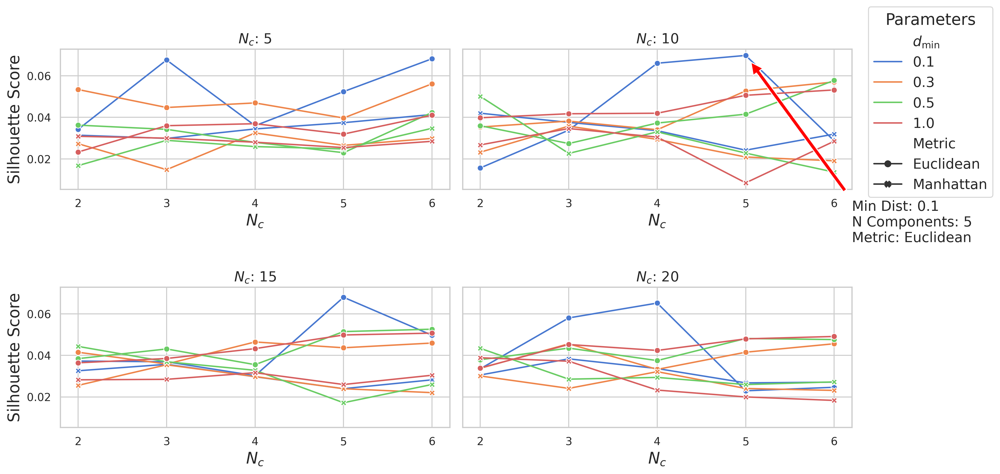

In [316]:
# param_grid = {
#     'n_neighbors': [5, 10, 15, 20],
#     'min_dist': [0.1, 0.3, 0.5, 1.0],
#     'metric': ['euclidean', 'manhattan'],
#     'n_components': [2, 3, 4, 5, 6]
# }
# best_params = {'metric': 'euclidean', 'min_dist': 0.1, 'n_components': 5, 'n_neighbors': 10}



sns.set(style='whitegrid', font_scale=1)

# plot subplots for each number of neighbors a plot and then all other params in the same plot
fig, axs = plt.subplots(2, 2, figsize=(14, 7), sharey=True, dpi=300, constrained_layout=True)
axs = axs.flatten()
for i, n_neighbors in enumerate(param_grid['n_neighbors']):
    sns.lineplot(data=results_df[results_df['n_neighbors'] == n_neighbors], x='n_components', y='score', hue='min_dist', style='metric', markers=True, dashes=False, palette='muted', ax=axs[i])
    axs[i].set_title(r'$N_c$' + f': {n_neighbors}', fontsize=14)
    axs[i].set_xlabel(r'$N_c$')
    axs[i].set_ylabel('Silhouette Score')
    legend = axs[i].legend(title='Parameters', bbox_to_anchor=(1.38, 1.35), loc='upper right', fontsize=14, title_fontsize=16)
    
    for text in legend.get_texts():
        if text.get_text() == 'min_dist':
            text.set_text(r'$d_{\min}$')
        elif text.get_text() == 'metric':
            text.set_text('Metric')


    # remove legend if it isnt the second plot
    if i != 1:
        axs[i].get_legend().remove()

    # add grid 
    axs[i].grid(True)
    # only keep integers
    axs[i].xaxis.set_major_locator(plt.MaxNLocator(integer=True))
    
    # increase font size of the x and y labels
    axs[i].xaxis.label.set_size(16)
    axs[i].yaxis.label.set_size(16)


# put a red arrow and text to show the best point in the correct subplot
# best_n_neighbors = best_params['n_neighbors']
# best_n_components = best_params['n_components']
# best_min_dist = best_params['min_dist']
# best_metric = best_params['metric']
best_score = best_score
# axs[param_grid['n_neighbors'].index(best_n_neighbors)].annotate('Best', xy=(best_n_components, best_score), xytext=(best_n_components, best_score + 0.01),
#             arrowprops=dict(facecolor='red', shrink=0.05))
# do it manually: Best parameters: {'metric': 'euclidean', 'min_dist': 0.1, 'n_components': 5, 'n_neighbors': 10}
axs[1].annotate('Min Dist: 0.1\nN Components: 5\nMetric: Euclidean',
                xy=(5, 0.07), xytext=(6.2, -0.02),
                fontsize=14,
                arrowprops=dict(facecolor='red', shrink=0.05,
                            # connectionstyle="arc3,rad=.5",
                            # linestyle='dashed'
                            ))

plt.tight_layout()
plt.show()



Fit UMAP with the Best Parameters:


In [317]:
# best_params = {'metric': 'euclidean', 'min_dist': 0.1, 'n_components': 5, 'n_neighbors': 10}

best_reducer = umap.UMAP(n_neighbors=best_params['n_neighbors'], min_dist=best_params['min_dist'], metric=best_params['metric'], n_components=best_params['n_components'], random_state=42)
best_embedding = best_reducer.fit_transform(X_scaled)

umap_result = best_embedding.copy()
umap_df = pd.DataFrame(umap_result, columns=[f'UMAP{i+1}' for i in range(umap_result.shape[1])])


aggregated_data = data_cleaned.copy()
umap_df['census_tract_id'] = aggregated_data['census_tract_id']
umap_df

/home/mohammed/miniconda3/envs/oxe_dash/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



,UMAP1,UMAP2,UMAP3,UMAP4,UMAP5,census_tract_id
0,5.324759,8.739054,7.277343,6.073350,7.673935,9110400101
1,5.385496,8.643008,6.564764,7.135562,7.912130,9110400102
2,5.695424,9.068827,7.801274,6.074081,7.306258,9110400200
3,4.426844,7.779685,6.476120,7.500033,7.883718,9110400300
4,5.240202,7.915087,7.308212,6.623810,7.991474,9110415300
...,...,...,...,...,...,...
2475,8.570038,12.185274,9.388142,7.369834,6.160703,25027761401
2476,8.558337,12.208297,9.396056,7.418632,6.138029,25027761402
2477,7.022885,11.253852,9.546098,6.475631,6.502968,44005041701
2478,6.799222,11.129443,10.259074,7.957565,5.362234,44005041702


Visualize the Best Embedding:


In [318]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import RandomForestRegressor



original_df = aggregated_data.copy()
umap_df_ = umap_df.copy().drop(columns=['census_tract_id'])

# Function to train a regression model and get top 5 feature importances
def get_top_feature_importances(X, y, feature_names, umap_component, top_n=7):
    
    # model = RandomForestRegressor(random_state=0)
    # use the best model parameters here as well {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 150}
    model = RandomForestRegressor(bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=150, random_state=42)
    model.fit(X, y)
    importances = model.feature_importances_
    importance_df = pd.DataFrame({
        'Feature': feature_names,
        'Importance': importances
    }).sort_values(by='Importance', ascending=False).head(top_n)
    return importance_df, umap_component

# Calculate top 5 feature importances for each UMAP component
importance_dfs = []
# remove veh_type_Passenger Car from the original_df columns
# original_df = original_df.drop(columns=['veh_type_Passenger Car'])
# remove any vehicle types
# original_df = original_df.drop(columns=[col for col in original_df.columns if 'veh_type' in col])
for umap_component in umap_df_.columns:
    importance_df, component = get_top_feature_importances(original_df, umap_df_[umap_component], original_df.columns, umap_component)
    importance_df['UMAP_Component'] = component
    importance_dfs.append(importance_df)


## Shap values : took 8 minutes to run one component

In [319]:

# # do shap values
# import shap
# # Create a SHAP explainer
# def get_shap_values(X, y, feature_names):
#     model = RandomForestRegressor(bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=150, random_state=42)
#     model.fit(X, y)
#     explainer = shap.Explainer(model)
#     shap_values = explainer(X)
#     return shap_values

# shap_dfs = []
# for umap_component in umap_df_.columns:
#     break
#     shap_values = get_shap_values(original_df, umap_df_[umap_component], original_df.columns)
#     shap_df = pd.DataFrame(shap_values.values, columns=original_df.columns)
#     shap_df['UMAP_Component'] = umap_component
#     shap_dfs.append(shap_df)
#     break


In [320]:

# # Combine the results of shaps
# shap_df = pd.concat(shap_dfs)
# shap_df = shap_df.melt(id_vars='UMAP_Component', var_name='Feature', value_name='SHAP Value')
# shap_df['Feature'] = shap_df['Feature'].str.replace('_', ' ').str.title()
# shap_df['UMAP_Component'] = shap_df['UMAP_Component'].str.replace('UMAP', '').astype(int)
# shap_df

# #plot
# plt.figure(figsize=(20, 10))
# sns.barplot(data=shap_df, x='SHAP Value', y='Feature', hue='UMAP_Component', palette='viridis')

# plt.title('SHAP Values for UMAP Components')
# plt.show()


In [321]:
# shap_df

/tmp/ipykernel_3701303/1370617519.py:34: UserWarning:

The figure layout has changed to tight



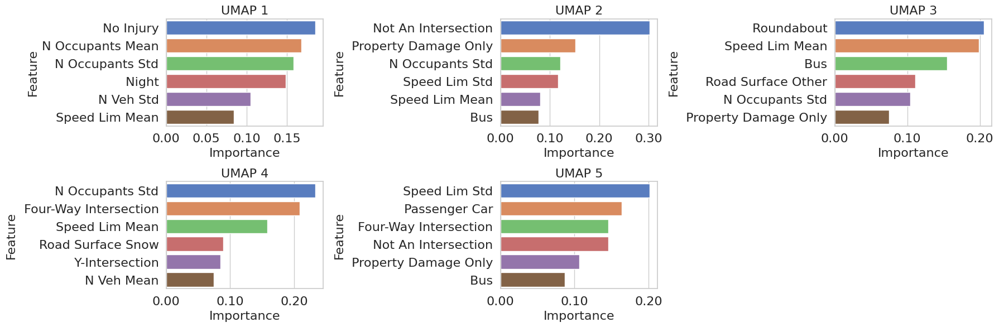

,Feature,Importance,UMAP_Component
42,Speed Lim Std,0.201785,UMAP5
48,Passenger Car,0.163620,UMAP5
23,Four-Way Intersection,0.145820,UMAP5
25,Not An Intersection,0.145805,UMAP5
5,Property Damage Only,0.106215,UMAP5


In [322]:

# drop the census_tract_id from the feature importance
for importance_df in importance_dfs:
    importance_df.drop(importance_df[importance_df['Feature'] == 'census_tract_id'].index, inplace=True)
    # normalize the remaining importance for each umap component by dividing by the sum
    importance_df['Importance'] = (importance_df['Importance'] / importance_df['Importance'].sum()) * 0.85



# remove the underscore from the feature names and make them title case
for importance_df in importance_dfs:
    
    importance_df['Feature'] = importance_df['Feature'].str.replace('_', ' ').str.title()
    # remove the sentences crash_severity, injury_status, intersection_type, veh_type, hour
    importance_df['Feature'] = importance_df['Feature'].str.replace('Crash Severity', '').str.replace('Injury Status', '').str.replace('Intersection Type', '').str.replace('Veh Type', '').str.replace('Hour', '').str.replace('Day Of Week', '')
    

# Plot top feature importances for each UMAP component
# Plot in 2 rows instead
fig, axs = plt.subplots(2, 3, figsize=(18, 6), sharey=False, sharex=False, dpi=100, constrained_layout=True)
axs = axs.flatten()
# remove last axis
fig.delaxes(axs[-1])
for ax, importance_df, umap_component in zip(axs, importance_dfs, umap_df.columns):
    sns.barplot(data=importance_df, x='Importance', y='Feature', ax=ax, palette='muted')
    ax.set_title(f'UMAP {umap_component[4]}', fontsize=16)
    ax.set_xlabel('Importance', fontsize=16)
    ax.set_ylabel('Feature', fontsize=16)
    
    # x labels should be rounded to 2 decimal places
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))
    # increase font size of the x and y ticks
    ax.xaxis.set_tick_params(labelsize=16)
    ax.yaxis.set_tick_params(labelsize=16)
plt.tight_layout( pad=1.0)
plt.show()

# display the data
display(importance_df.head())
# save the data as csv
importance_df.to_csv('umap_comps_feature_importance2.csv', index=False)

/home/mohammed/miniconda3/envs/oxe_dash/lib/python3.10/site-packages/seaborn/axisgrid.py:712: UserWarning:

Using the barplot function without specifying `order` is likely to produce an incorrect plot.



<Figure size 1920x1440 with 0 Axes>

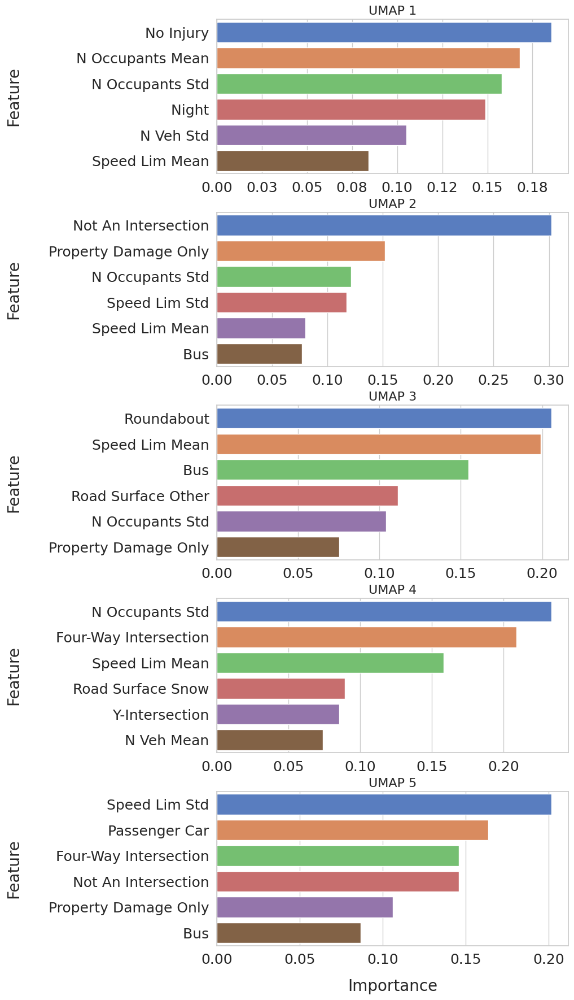

,Feature,Importance,UMAP_Component,UMAP Component
19,No Injury,0.185581,UMAP1,UMAP 1
29,N Occupants Mean,0.168116,UMAP1,UMAP 1
30,N Occupants Std,0.158097,UMAP1,UMAP 1
16,Night,0.148811,UMAP1,UMAP 1
32,N Veh Std,0.105180,UMAP1,UMAP 1


In [323]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Assuming `importance_dfs` is a list of DataFrames and `umap_df` contains the UMAP components
# Drop the 'census_tract_id' and normalize the importance
for importance_df in importance_dfs:
    importance_df.drop(importance_df[importance_df['Feature'] == 'census_tract_id'].index, inplace=True)
    importance_df['Importance'] = (importance_df['Importance'] / importance_df['Importance'].sum()) * 0.85

# Remove underscores, make title case, and clean up feature names
for importance_df in importance_dfs:
    importance_df['Feature'] = (
        importance_df['Feature']
        .str.replace('_', ' ')
        .str.title()
        .str.replace('Crash Severity', '')
        .str.replace('Injury Status', '')
        .str.replace('Intersection Type', '')
        .str.replace('Veh Type', '')
        .str.replace('Hour', '')
        .str.replace('Day Of Week', '')
    )

# Combine the importance DataFrames with an indicator for UMAP component
for i, importance_df in enumerate(importance_dfs):
    importance_df['UMAP Component'] = f'UMAP {i+1}'

# Concatenate all the importance DataFrames for facet plotting
df_combined = pd.concat(importance_dfs, axis=0)

# Create the figure with specified DPI
fig = plt.figure(dpi=300)

# Define the FacetGrid for horizontal bar plots
g = sns.FacetGrid(df_combined, col="UMAP Component", col_wrap=1, height=3.5, aspect=2.5, sharey=False, sharex=False, margin_titles=True,
                    despine=False)

# Map the barplot to the FacetGrid with horizontal orientation
g.map(sns.barplot, "Importance", "Feature", palette='muted', orient='h')

# Set titles and labels with increased font size
g.set_axis_labels("Importance", "", fontsize=20, labelpad=15)
# add extra y label named 'plotss' at a distance of 100 from the axis for each plot
for ax in g.axes.flat:
    # add a text to the left of the plot at 10 cm
    ax.text(-0.6, 0.5, 'Feature', va='center', rotation='vertical', fontsize= 20, transform=ax.transAxes)
# set all y labels to be the same distance from the axis
# g.set_titles("Feature", col_template="{col_name}", size=20, position=(0.5, 1.05))

# Increase the tick label font size for both axes
for ax in g.axes.flatten():
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))  # Format x labels
    ax.tick_params(axis='x', labelsize=18)  # Set font size for x-axis ticks
    ax.tick_params(axis='y', labelsize=18)  # Set font size for y-axis ticks


# set titles for each plot
for ax, title in zip(g.axes.flat, ['UMAP 1', 'UMAP 2', 'UMAP 3', 'UMAP 4', 'UMAP 5']):
    ax.set_title(title, fontsize=16)

# Adjust the title font size
for ax in g.axes.flat:
    ax.set_title(ax.get_title(), fontsize=16)

# Adjust the layout
# g.fig.tight_layout(pad=1.0)
plt.show()

# Display the data
display(df_combined.head())

# Save the data as CSV
df_combined.to_csv('umap_comps_feature_importance2.csv', index=False)


/tmp/ipykernel_3701303/4006382083.py:33: FutureWarning:

The default value of regex will change from True to False in a future version.

/tmp/ipykernel_3701303/4006382083.py:33: FutureWarning:

The default value of regex will change from True to False in a future version.



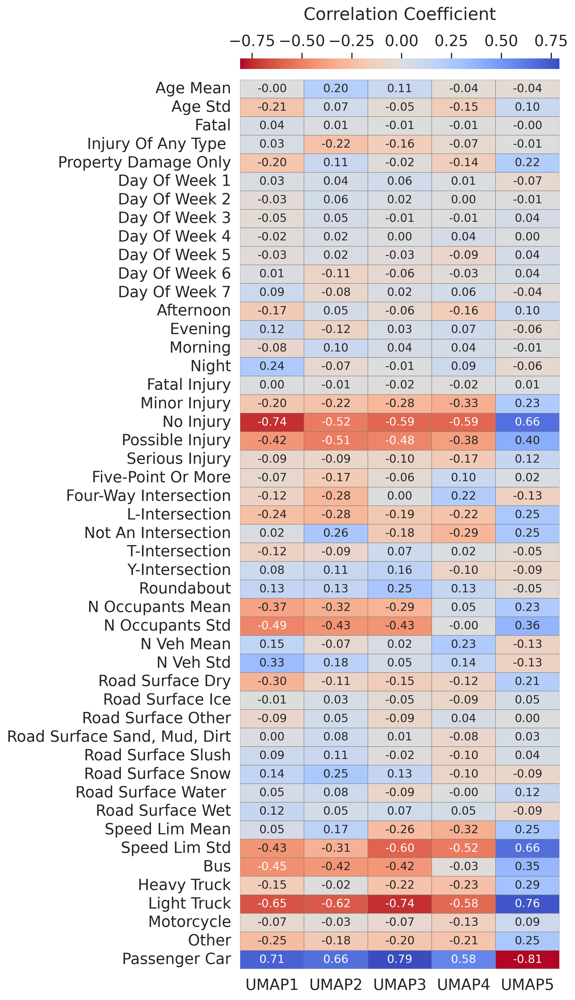

In [324]:
# do shap values instead of feature importance
import shap
from sklearn.ensemble import RandomForestRegressor



# Assuming X_scaled is your scaled data and embedding is the UMAP result
# umap_df = pd.DataFrame(embedding, columns=[f'UMAP_{i+1}' for i in range(embedding.shape[1])])
# original_df = pd.DataFrame(X_scaled, columns=[f'Feature_{i+1}' for i in range(X_scaled.shape[1])])
# Calculate the correlation matrix
temp_ = pd.concat([original_df, umap_df_], axis=1)
# sort the columns
temp_ = temp_.sort_index(axis=0)
correlation_matrix = temp_.corr()

correlation_matrix = correlation_matrix.sort_index(axis=1)


# Extract correlations of UMAP components with original features
# umap_correlations = correlation_matrix.iloc[:original_df.shape[1], -umap_df.shape[1]:]
umap_correlations = correlation_matrix.loc[original_df.columns, umap_df_.columns]
# sort the columns
umap_correlations = umap_correlations.sort_index(axis=0)
umap_correlations = umap_correlations.sort_index(axis=1)
# remove census_tract_id
umap_correlations = umap_correlations.drop(index='census_tract_id', errors='ignore')

# remove the underscore from the feature names and make them title case
umap_correlations.columns = umap_correlations.columns.str.replace('_', ' ').str.title()
umap_correlations.index = umap_correlations.index.str.replace('_', ' ').str.title()
# remove the sentences crash_severity, injury_status, intersection_type, veh_type, hour
umap_correlations.columns = umap_correlations.columns.str.replace('Crash Severity', '').str.replace('Injury Status', '').str.replace('Intersection Type', '').str.replace('Veh Type', '').str.replace('Hour', '').str.replace('Day Of Week', '')
umap_correlations.index = umap_correlations.index.str.replace('Crash Severity', '').str.replace('Injury Status', '').str.replace('Intersection Type', '').str.replace('Veh Type', '').str.replace('Hour', '').str.replace('\(Serious, Minor, Possible\)', '').str.replace(', Oil, Gravel', '').str.replace('\(Standing, Moving\)', '')
index = umap_correlations.index
# now replace the index that has Day Of Week in it and replace the .0 with ''
# create a replacement list
replacement = []
for i, ind in enumerate(index):
    if 'Day Of Week' in ind:
        replacement.append(ind.replace('.0', ''))
    else:
        replacement.append(ind)
# replace the index
umap_correlations.index = replacement


umap_correlations.columns = umap_correlations.columns.str.replace('Umap', 'UMAP')



# Plot the heatmap
plt.figure(figsize=(6, 20), dpi=300)
sns.heatmap(umap_correlations, cmap='coolwarm_r', annot=True, fmt='.2f', 
            # Font size
            annot_kws={'size': 12},
            square=False, cbar_kws={'shrink': 1, 'orientation': 'horizontal', 'pad': 0.01, 'aspect': 30, 'location': 'top'},
            linewidths=0.1, linecolor='grey')
# plt.title('Correlation Matrix Heatmap')
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
# increase font size of the color bar labels
cbar = plt.gcf().axes[-1]
cbar.tick_params(labelsize=16)
# now the cbar title
cbar.set_xlabel('Correlation Coefficient', fontsize=18, rotation=0, labelpad=15, )
# set color bar ticks from -1 to 1
cbar.set_xticks([-0.75, -0.5, -0.25, 0, 0.25, 0.5, 0.75])
plt.show()

%%%%%%%%%%%%%%%%%%%%%%%%%%

/tmp/ipykernel_3701303/3834389466.py:38: UserWarning:

The figure layout has changed to tight



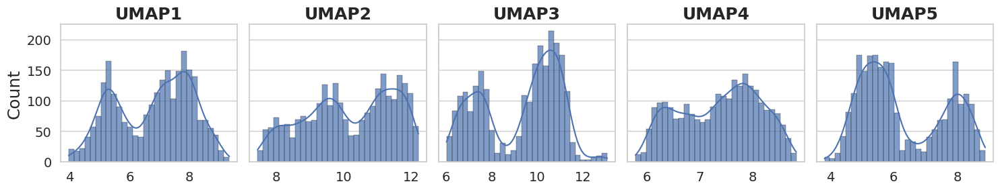

In [325]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import umap
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
from tqdm import tqdm


import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import umap
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import StandardScaler
# Alternative visualization of transformed features (assuming original features are important)
fig, axs = plt.subplots(1, 5, figsize=(15, 3), dpi=100, sharey=True, constrained_layout=True, sharex=False)
axs = axs.flatten()
# remove the last one
# plt.delaxes(axs[-1])
for i, ax in enumerate(axs):
    # print(i)
    # if i >= umap_df.shape[1] - 1:
    #     break
    sns.histplot(umap_df[f'UMAP{i + 1}'], ax=ax, kde=True, bins=30, alpha=0.7, 
                    edgecolor='black', linewidth=0.2)
    ax.set_title(f'UMAP{i + 1}', fontsize=18, fontweight='bold')
    ax.set_xlabel('')
    ax.set_ylabel('Count', fontsize=18)
    ax.grid(axis='x')
    # increase x and y tick font size
    ax.tick_params(axis='both', which='major', labelsize=14)


plt.tight_layout()
plt.show()



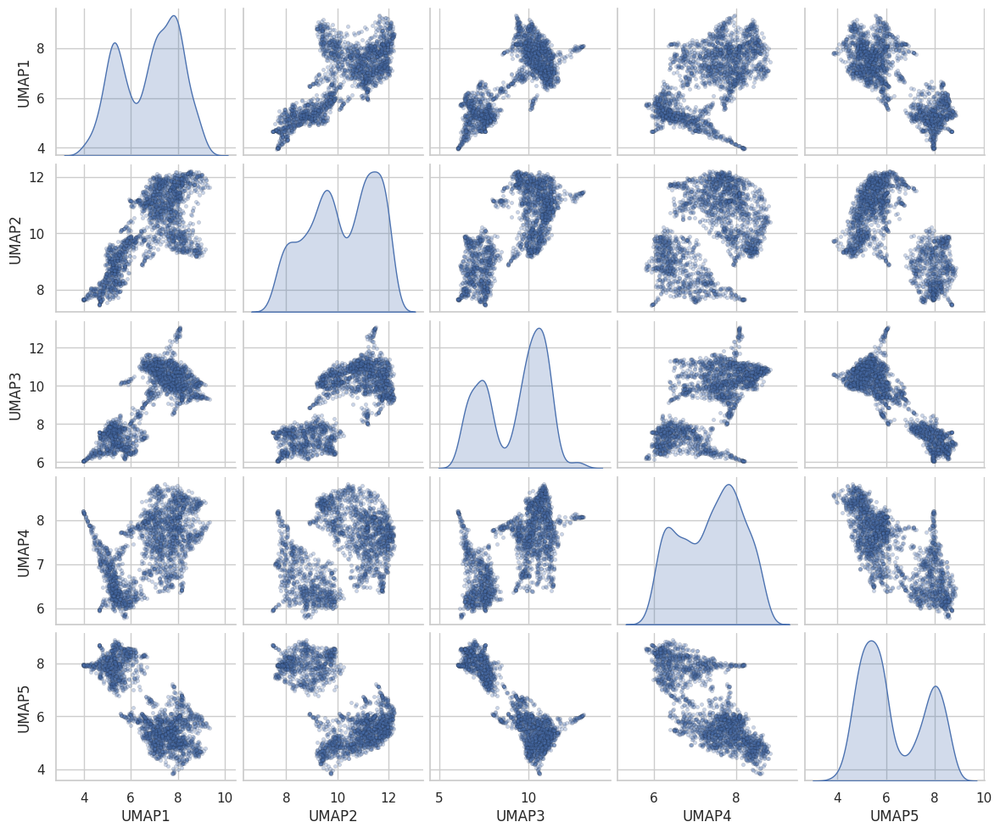

In [326]:
# fig, axs = plt.subplots(3, 3, figsize=(10, 10), dpi=100, sharey=True, constrained_layout=True, sharex=True)
# axs = axs.flatten()
# # all combinations
# combs = [(i, j) for i in range(umap_result.shape[1]) for j in range(i+1, umap_result.shape[1])]
# for i, ax in enumerate(axs):
#     if i >= len(combs):
#         break
#     x, y = combs[i]
#     sns.scatterplot(data=umap_df, x=f'UMAP{x+1}', y=f'UMAP{y+1}', palette='muted', s=10, alpha=0.3, ax=ax,
#                     edgecolor='black', linewidth=0.2)
#     ax.set_title(f'UMAP{x+1} vs. UMAP{y+1}', fontsize=14, fontweight='bold')
#     # set x and y labels
#     ax.set_xlabel(f'UMAP{x+1}', fontsize=16)
#     ax.set_ylabel(f'UMAP{y+1}', fontsize=16)
#     ax.grid(False)
    
# # plt.delaxes(axs[-1])

# plt.tight_layout()
# plt.show()


umap_df_pair_orig = umap_df.copy()
# remove the census_tract_id
umap_df_pair_orig = umap_df_pair_orig.drop(columns=['census_tract_id'])
# do a pairplot instead
sns.set(style='whitegrid', font_scale=1)
# plot the pairplot
# fig, ax = plt.subplots(figsize=(20, 20), dpi=100)
sns.pairplot(umap_df_pair_orig, diag_kind='kde', 
                plot_kws={'alpha': 0.3, 's': 10, 'edgecolor': 'black', 'linewidth': 0.2},
                # diag_kws={'color': 'black', 'linewidth': 0.5, 'shade': False},
                # corner=True,
                # palette='muted',
                height=2,
                markers='o',
                # set the aspect ratio
                aspect=1.2,
)
# plt.title('Pairplot of UMAP Components')
# change font size of the x and y labels
plt.xticks(fontsize=10)
plt.yticks(fontsize=20)

plt.show()

In [327]:
# make a 3d plot of the first 3 PCs and use plotly
import plotly.express as px
# create a 3d plot
fig = px.scatter_3d(umap_df, x='UMAP1', y='UMAP2', z='UMAP3',
                    color='census_tract_id', opacity=0.3, 
                    size_max=2, width=1000, height=1000,
                    title='3D Biplot of the First 3 Principal Components',
                    labels={ 'census_tract_id': 'Census Tract ID'},
                    # template='ggplot2',
                    )          
fig.show()
fig = px.scatter_3d(umap_df, x='UMAP3', y='UMAP4', z='UMAP5',
                    size_max=2, width=1000, height=1000,
                    color='census_tract_id', opacity=0.3,
                    title='3D Biplot of the Next 3 Principal Components',
                    labels={'census_tract_id': 'Census Tract ID'},
                    # template='ggplot2',
                    )
fig.show()

# fig = px.scatter_3d(umap_df, x='UMAP7', y='UMAP8', z='UMAP9',
#                     size_max=2, width=1000, height=1000,   
#                     color='census_tract_id', opacity=0.3,
#                     title='3D Biplot of the Next 3 Principal Components',
#                     labels={'census_tract_id': 'Census Tract ID'},
#                     # template='ggplot2',
#                     )
# fig.show()

Correlation Heatmap Between Original Features and PCs

### Cluster


2. Gaussian Mixture Models (GMM):

In [328]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA
from itertools import product


# Parameters to search over
# Parameters to search over
n_components_range = range(2, 11)
covariance_types = ['full', 'tied', 'diag', 'spherical']
tol_range = [1e-3, 1e-4]
reg_covar_range = [1e-6, 1e-5, 1e-4]
# max_iter_range = [100, 150, 200, 300]
# n_init_range = [1, 2, 3, 4] # this is the number of initializations to perform
# init_params_range = [ 'random', ]

# Store BIC values and parameters
bic = []
params = []

# Calculate the total number of iterations for tqdm
total_iterations = len(n_components_range) * len(covariance_types) * len(tol_range) * len(reg_covar_range) #* len(max_iter_range)# * len(n_init_range) * len(init_params_range)


# Function to evaluate a single combination of parameters
def evaluate_gmm(params):
    n_components, cov_type, tol, reg_covar= params #, max_iter, n_init, init_params 
    gmm = GaussianMixture(
        n_components=n_components,
        covariance_type=cov_type,
        tol=tol,
        reg_covar=reg_covar,
        max_iter=250,
        n_init=1,
        init_params='random',
        random_state=100
    )
    gmm.fit(umap_result)
    bic_value = gmm.bic(umap_result)
    return bic_value, params

# Generate all combinations of parameters
param_combinations = list(product(n_components_range, covariance_types, tol_range, reg_covar_range))#, max_iter_range, n_init_range, init_params_range))

# Perform parallel grid search using joblib
results = joblib.Parallel(n_jobs=-1)(
    joblib.delayed(evaluate_gmm)(params) for params in tqdm(param_combinations, total=total_iterations)
)

# Collect the results
for bic_value, param_set in results:
    bic.append(bic_value)
    params.append(param_set)


# Convert lists to numpy arrays for easier indexing
bic = np.array(bic)
params = np.array(params)

# Find the best parameters
best_index = np.argmin(bic)
best_params = params[best_index]
best_bic = bic[best_index]

best_params_dic = {
    'n_components': best_params[0],
    'covariance_type': best_params[1],
    'tol': best_params[2],
    'reg_covar': best_params[3],
    # 'max_iter': best_params[4],
    # 'n_init': best_params[5],
    # 'init_params': best_params[6]
}
print("Best parameters:", best_params_dic)
# create a dataframe
gmm_grid_search = pd.DataFrame(params, columns=['n_components', 'covariance_type', 'tol', 'reg_covar'])#, 'max_iter', 'n_init', 'init_params'
gmm_grid_search['bic'] = bic
# convert floats and int
gmm_grid_search['n_components'] = gmm_grid_search['n_components'].astype(int)
gmm_grid_search['bic'] = gmm_grid_search['bic'].astype(float)
gmm_grid_search['tol'] = gmm_grid_search['tol'].astype(float)
gmm_grid_search['reg_covar'] = gmm_grid_search['reg_covar'].astype(float)
gmm_grid_search['bic'] = gmm_grid_search['bic'].astype(float)
# convert each element in best_params_dic to the same types
best_params_dic = {k: type(v)(best_params_dic[k]) for k, v in best_params_dic.items()}
# $ make the covariance type capitalized
gmm_grid_search['covariance_type'] = gmm_grid_search['covariance_type'].str.capitalize()
# convert diag to Diagonal
gmm_grid_search['covariance_type'] = gmm_grid_search['covariance_type'].str.replace('diag', 'Diagonal')
gmm_grid_search

100%|██████████| 216/216 [00:00<00:00, 5193.71it/s]


Best parameters: {'n_components': '9', 'covariance_type': 'full', 'tol': '0.0001', 'reg_covar': '0.0001'}


,n_components,covariance_type,tol,reg_covar,bic
0,2,Full,0.0010,0.000001,26573.428475
1,2,Full,0.0010,0.000010,26573.429014
2,2,Full,0.0010,0.000100,26573.437976
3,2,Full,0.0001,0.000001,24394.330533
4,2,Full,0.0001,0.000010,24394.338097
...,...,...,...,...,...
211,10,Spherical,0.0010,0.000010,21144.327083
212,10,Spherical,0.0010,0.000100,21144.381232
213,10,Spherical,0.0001,0.000001,21141.227757
214,10,Spherical,0.0001,0.000010,21141.229426


Text(11, 24896.179860284825, 'Best BIC: 16896.2\nComponents: 9\nCovariance Type: full')

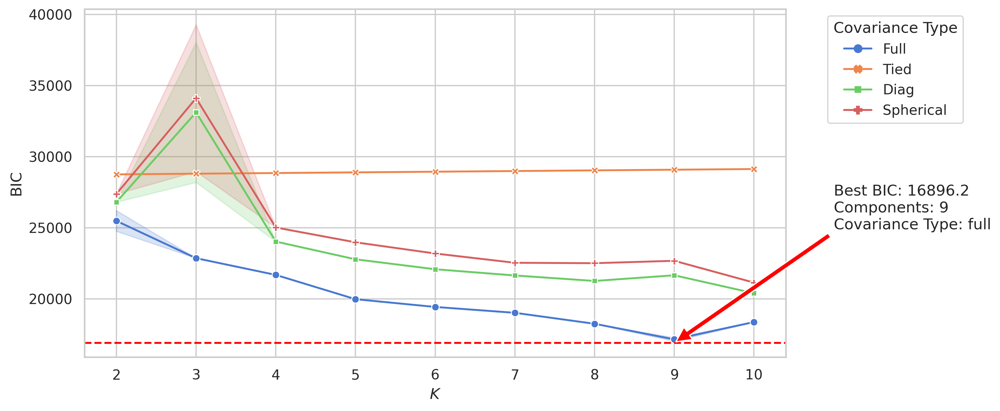

In [329]:

# plot one plot with the style ebiug the covariance type and the hue being the number of components
fig, ax = plt.subplots(figsize=(10, 5), dpi=300)
sns.lineplot(data=gmm_grid_search, x='n_components', y='bic', hue='covariance_type', style='covariance_type', markers=True, dashes=False, palette='muted', ax=ax)
# ax.set_title('BIC vs Number of Components')
ax.set_xlabel(r'$K$')
ax.set_ylabel('BIC')
ax.legend(title='Covariance Type', bbox_to_anchor=(1.05, 1), loc='upper left')
# add grid 
ax.grid(True)
# add a dashed red line to show the best point
# ax.axvline(x=best_params_dic['n_components'], color='red', linestyle='--')
best_bic = gmm_grid_search.bic.min()
ax.axhline(y=best_bic, color='red', linestyle='--')
# add arrow pointing towards the best point and saying the bic value
# y log set
ax.annotate(f'Best BIC: {round(best_bic,1)}\nComponents: {best_params_dic["n_components"]}\nCovariance Type: {best_params_dic["covariance_type"]}',
            xy=(9, best_bic), xytext=(11, best_bic + 8000),
            arrowprops=dict(facecolor='red', shrink=0.01))



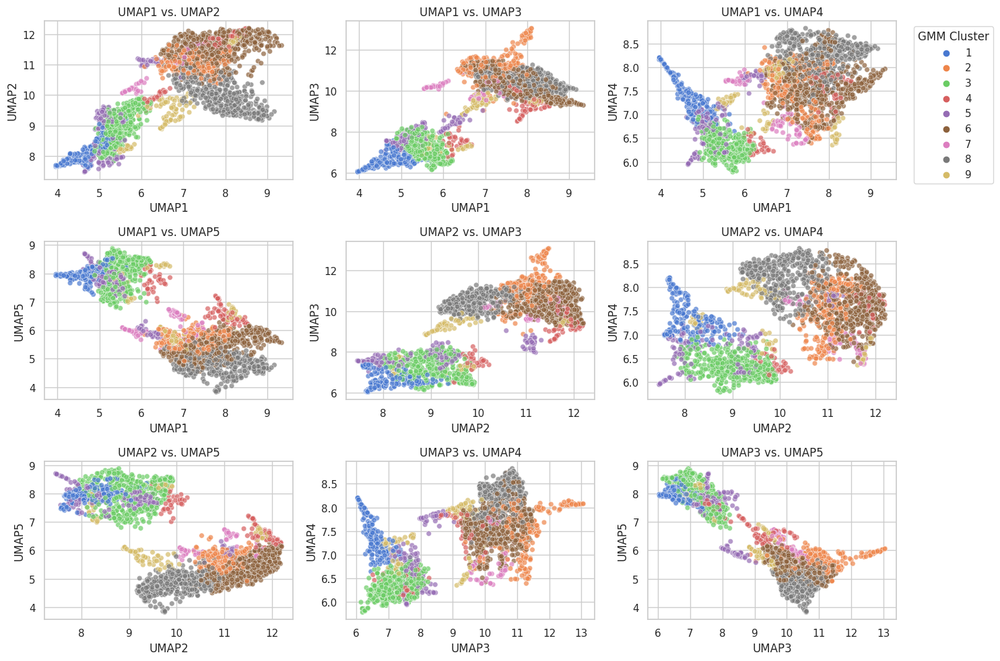

In [330]:
# Fit GMM with default parameters
best_params_dic = {'n_components': '9', 'covariance_type': 'full', 'tol': '0.0001', 'reg_covar': '0.0001'}
gmm = GaussianMixture(n_components= int(best_params_dic['n_components']), 
                        covariance_type= best_params_dic['covariance_type'],
                        tol= float(best_params_dic['tol']),
                        reg_covar= float(best_params_dic['reg_covar']),
                        init_params='random',
                        random_state=42)
# gmm_labels = gmm.fit_predict(umap_result)
# avoid TypeError: '<' not supported between instances of 'int' and 'numpy.str_' by converting the column to string

gmm_labels = gmm.fit_predict(umap_result)

# Create a DataFrame for UMAP results
# umap_df = pd.DataFrame(umap_result, columns=['UMAP1', 'UMAP2', 'UMAP3', 'UMAP4', 'UMAP5'])



# umap_df = pd.DataFrame(umap_result, columns=[f'UMAP{i+1}' for i in range(umap_result.shape[1])])
# umap_df['census_tract_id'] = aggregated_data['census_tract_id']
umap_df['GMM Cluster'] = gmm_labels + 1


# # Plot the UMAP results
# plt.figure(figsize=(10, 6))
# sns.scatterplot(data=umap_df, x='UMAP1', y='UMAP2', hue='GMM Cluster', palette='muted', s=30, alpha=0.7)
# plt.title('UMAP Projection with GMM Clustering')
# plt.show()

# plot all combinations of the 5 UMAP components scatter plots against each other
fig, axs = plt.subplots(3, 3, figsize=(15, 10), dpi=100)
axs = axs.flatten()
# all combinations
combs = [(i, j) for i in range(umap_result.shape[1]) for j in range(i+1, umap_result.shape[1])]
for i, ax in enumerate(axs):
    if i >= len(combs):
        break
    x, y = combs[i]
    sns.scatterplot(data=umap_df, x=f'UMAP{x+1}', y=f'UMAP{y+1}', hue='GMM Cluster', palette='muted', s=30, alpha=0.7, ax=ax)
    ax.set_title(f'UMAP{x+1} vs. UMAP{y+1}')
    ax.legend(title='GMM Cluster', bbox_to_anchor=(1.05, 1), loc='upper left')
    # remove all legends except the third plot
    if i != 2:
        ax.get_legend().remove()
    # make the legend outside the plot
    
# plt.delaxes(axs[-1])

plt.tight_layout()
plt.show()


In [331]:
# plot a pairplot of the umap_df with the hue being the GMM Cluster
# set dpi to 300

# Replace the names iof the UMAP components to: 
# UMAP1: Low Severity Night Crashes
# UMAP2: Non-Intersection Property Damage
# UMAP3: Transit Roundabout Crashes
# UMAP4: Adverse Weather Intersection Crashes
# UMAP5: Variable Speed Crashes

temp_ = umap_df.copy()
temp_['GMM Cluster'] = gmm_labels + 1
# remove census_tract_id
temp_ = temp_.drop(columns=['census_tract_id'])
temp_

# Function to split labels into two lines after the first two words
def split_label(label):
    parts = label.split(' ', 2)  # Split at the second space
    if len(parts) > 2:
        return parts[0] + ' ' + parts[1] + '\n' + parts[2]
    else:
        return label
# Function to split labels into three lines after the first two words
def split_label_3places(label):
    parts1_2 = label.split(' ', 3)  # Split at the second space
    # print(parts1_2)
    try:
        if len(parts1_2) > 2:
            # return parts1_2[0] + ' ' + parts1_2[1] + '\n' +
            # combine into a single string with spaces added between the parts and \n added twice in between
            return ' '.join(parts1_2[0:1]) + '\n' + ' '.join(parts1_2[1:3]) + '\n' + ' '.join(parts1_2[3:])
        else:
            return split_label(label)
    except:
        return split_label(label)



# crash_type_dict = {
#     1: "Urban Variable Speed",
#     2: "Urban/Suburban Transport/Weather",
#     3: "Urban High Speed",
#     4: "Urban/Suburban Non-Intersection",
#     5: "Urban Low Speed",
#     6: "Hybrid Non-Intersection",
#     7: "Rural Low Severity",
#     8: "Urban Intersection",
#     9: "Urban/Suburban Avg Speed"
# }

# cluster_names = [crash_type_dict[i+1] for i in range(9)]
# # add 1., 2., 3., etc to the cluster names
# cluster_names = [f'{i+1}. {cluster_names[i]}' for i in range(9)]




crash_type_dict = {
    6: 'Hybrid Non-Intersection',
    7: 'Rural Lo-Severity',
    9: 'Suburban Mid-speed',
    4: 'Suburban Non-Intersection',
    2: 'Suburban Transit Inclement',
    3: 'Urban Hi-Speed',
    8: 'Urban Intersection',
    5: 'Urban Lo-Speed',
    1: 'Urban Variable Speed'
}

# # get cluster names by joining the keys and values
# cluster_names = [f'{k}. {v}' for k, v in crash_type_dict.items()]



temp_ = temp_.rename(columns={
    'UMAP1': 'UMAP1: Low Severity Night Crashes',
    'UMAP2': 'UMAP2: Non-Intersection Property Damage Crashes',
    'UMAP3': 'UMAP3: Transit Roundabout Crashes',
    'UMAP4': 'UMAP4: Adverse Weather Intersection Crashes',
    'UMAP5': 'UMAP5: Variable Speed Crashes'
})

# replace GMM Cluster using crash_type_dict with mapping
temp_['GMM Cluster'] = temp_['GMM Cluster'].map(crash_type_dict)
# sort GMM Cluster alphabetically wihtout converting to category
temp_['GMM Cluster'] = temp_['GMM Cluster'].astype('str')
# sort the GMM Cluster
temp_= temp_.sort_values(by='GMM Cluster')

temp_

,UMAP1: Low Severity Night Crashes,UMAP2: Non-Intersection Property Damage Crashes,UMAP3: Transit Roundabout Crashes,UMAP4: Adverse Weather Intersection Crashes,UMAP5: Variable Speed Crashes,GMM Cluster
1239,7.951906,11.445070,10.177996,7.247451,5.483541,Hybrid Non-Intersection
1530,8.168552,11.583030,10.134486,7.430884,5.730554,Hybrid Non-Intersection
1527,7.041823,11.583741,11.224393,7.417128,5.471377,Hybrid Non-Intersection
1526,6.945179,11.336141,10.820637,7.324791,4.757102,Hybrid Non-Intersection
1522,7.131617,11.757645,10.890817,7.389661,5.057995,Hybrid Non-Intersection
...,...,...,...,...,...,...
482,5.169837,9.108393,6.559914,7.107929,7.805329,Urban Variable Speed
483,4.093478,7.736778,6.191285,8.033857,7.900579,Urban Variable Speed
486,4.543313,7.837630,6.574286,7.312404,8.058651,Urban Variable Speed
542,4.637678,8.116563,6.941632,6.927042,7.826599,Urban Variable Speed


In [332]:
! pip install brewer2mpl



/bin/bash: /home/mohammed/miniconda3/envs/oxe_dash/lib/python3.10/site-packages/cv2/../../../../lib/libtinfo.so.6: no version information available (required by /bin/bash)


In [333]:
import brewer2mpl
brewer2mpl.print_maps('qualitative', 9)
bmap = brewer2mpl.get_map('Paired', 'Qualitative', 5)


Qualitative
Paired    :  {3, 4, 5, 6, 7, 8, 9, 10, 11, 12}
Pastel1   :  {3, 4, 5, 6, 7, 8, 9}
Set1      :  {3, 4, 5, 6, 7, 8, 9}
Set3      :  {3, 4, 5, 6, 7, 8, 9, 10, 11, 12}


In [334]:

qualitative_palette = sns.color_palette("Paired", 9)
# print the palette
qualitative_palette

[(0.6509803921568628, 0.807843137254902, 0.8901960784313725),
 (0.12156862745098039, 0.47058823529411764, 0.7058823529411765),
 (0.6980392156862745, 0.8745098039215686, 0.5411764705882353),
 (0.2, 0.6274509803921569, 0.17254901960784313),
 (0.984313725490196, 0.6039215686274509, 0.6),
 (0.8901960784313725, 0.10196078431372549, 0.10980392156862745),
 (0.9921568627450981, 0.7490196078431373, 0.43529411764705883),
 (1.0, 0.4980392156862745, 0.0),
 (0.792156862745098, 0.6980392156862745, 0.8392156862745098)]

/tmp/ipykernel_3701303/3227814731.py:21: MatplotlibDeprecationWarning:

The legendHandles attribute was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use legend_handles instead.



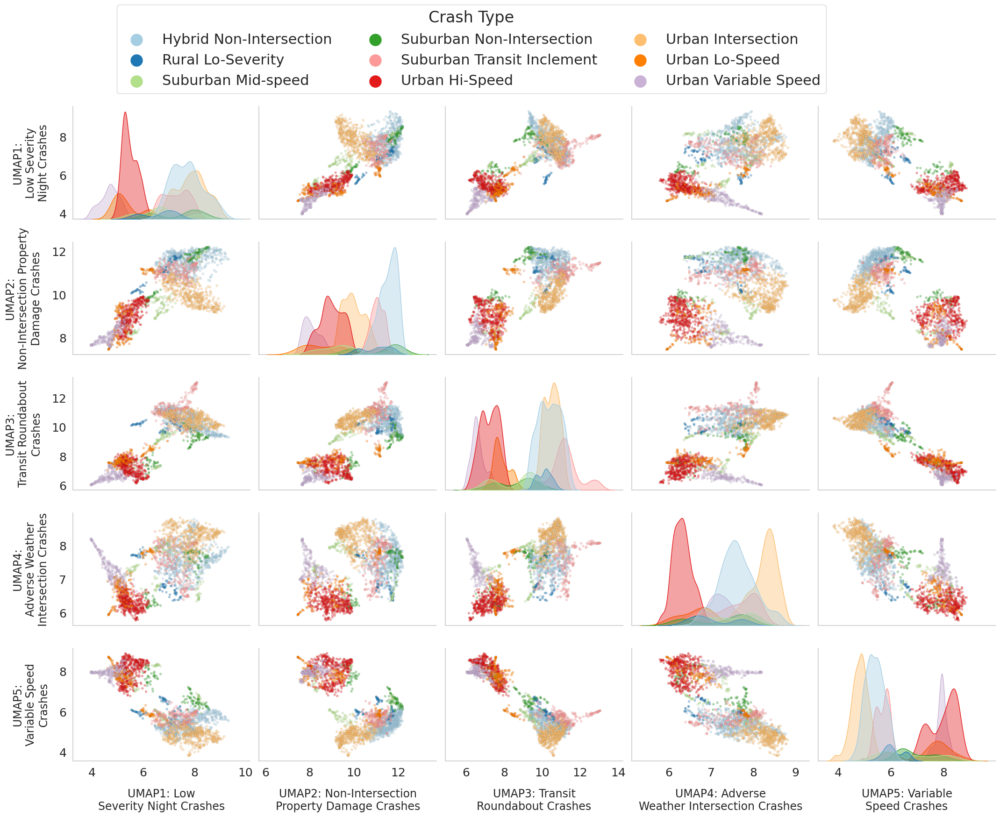

In [335]:



# plt.figure(dpi=100)
# fig, ax = plt.subplots(figsize=(15, 15), dpi=100)
pairplot = sns.pairplot(temp_, hue='GMM Cluster', palette=qualitative_palette,
                        diag_kind='kde', 
            height=3, # height controls the size of the plots
            aspect=1.4, # aspect controls the width of the plots
            plot_kws={'alpha': 0.4, 's': 13, 'edgecolor': 'black', 'linewidth': 0.1},
            diag_kws={'alpha': 0.4},
            corner=False,
            )

# Adjust the legend
pairplot._legend.set_bbox_to_anchor((0.5, 1.15))
pairplot._legend.set_title("GMM Cluster")
pairplot._legend.fontsize = 12



# Manually set the number of columns in the legend
# pairplot._legend.set_title("GMM Cluster")
pairplot.fig.legend(handles=pairplot._legend.legendHandles, 
                    # labels=[t.get_text() for t in pairplot._legend.get_texts()],
                    # labels=cluster_names,
                    loc='upper center', bbox_to_anchor=(0.4, 1.14), ncol=3, fontsize=22,
                    markerscale=3,
                    title='Crash Type',
                    title_fontsize='24',
                    # title_fontweight='bold',
                    )


# Adjust the font size of the x and y labels
# for ax in pairplot.axes.flatten():
#     if ax:
#         ax.set_xlabel(ax.get_xlabel(), fontsize=16)
#         ax.set_ylabel(ax.get_ylabel(), fontsize=16)
#         ax.tick_params(axis='both', which='major', labelsize=14)

# Adjust the font size of the x and y labels and split them into two lines
for ax in pairplot.axes.flatten():
    if ax:
        ax.set_xlabel(split_label(ax.get_xlabel()), fontsize=17, labelpad=15)
        ax.set_ylabel(split_label_3places(ax.get_ylabel()), fontsize=17, labelpad=15)
        ax.tick_params(axis='both', which='major', labelsize=18)
        # remove grid
        ax.grid(False)
        # 


# Remove the original legend to avoid duplication
pairplot._legend.remove()

# Adjust the spacing between plots
plt.subplots_adjust(hspace=0.2, wspace=0.05)  # Increase the hspace and wspace values to add more padding
# remove grid
# Show the plot
plt.show()





In [336]:

# # plt.figure(dpi=100)
# # fig, ax = plt.subplots(figsize=(15, 15), dpi=100)
# pairplot = sns.pairplot(temp_, hue='GMM Cluster', palette='muted', diag_kind='kde', 
#             height=3, # height controls the size of the plots
#             aspect=1.4, # aspect controls the width of the plots
#             plot_kws={'alpha': 0.2, 's': 15, 'edgecolor': 'black', 'linewidth': 0.3},
#             diag_kws={'alpha': 0.5},
#             corner=False,
#             )

# # Adjust the legend
# pairplot._legend.set_bbox_to_anchor((0.5, 1.15))
# pairplot._legend.set_title("GMM Cluster")
# pairplot._legend.fontsize = 12



# # Manually set the number of columns in the legend
# # pairplot._legend.set_title("GMM Cluster")
# pairplot.fig.legend(handles=pairplot._legend.legendHandles, 
#                     # labels=[t.get_text() for t in pairplot._legend.get_texts()],
#                     labels=cluster_names,
#                     loc='upper center', bbox_to_anchor=(0.5, 1.14), ncol=3, fontsize=22,
#                     markerscale=3,
#                     title='Crash Type',
#                     title_fontsize='24',
#                     # title_fontweight='bold',
#                     )


# # Adjust the font size of the x and y labels
# # for ax in pairplot.axes.flatten():
# #     if ax:
# #         ax.set_xlabel(ax.get_xlabel(), fontsize=16)
# #         ax.set_ylabel(ax.get_ylabel(), fontsize=16)
# #         ax.tick_params(axis='both', which='major', labelsize=14)

# # Adjust the font size of the x and y labels and split them into two lines
# for ax in pairplot.axes.flatten():
#     if ax:
#         ax.set_xlabel(split_label(ax.get_xlabel()), fontsize=17, labelpad=15)
#         ax.set_ylabel(split_label_3places(ax.get_ylabel()), fontsize=17, labelpad=15)
#         ax.tick_params(axis='both', which='major', labelsize=18)

# # Remove the original legend to avoid duplication
# pairplot._legend.remove()

# # Adjust the spacing between plots
# plt.subplots_adjust(hspace=0.2, wspace=0.05)  # Increase the hspace and wspace values to add more padding

# # Show the plot
# plt.show()

# # # get the muted color palette in list form
# # map_palette = sns.color_palette('muted')




In [337]:


# Old 
# # crash_type_dict = {
# #     1: "Urban Variable Speed",
# #     2: "Urban/Suburban Transport/Weather",
# #     3: "Urban High Speed",
# #     4: "Urban/Suburban Non-Intersection",
# #     5: "Urban Low Speed",
# #     6: "Hybrid Non-Intersection",
# #     7: "Rural Low Severity",
# #     8: "Urban Intersection",
# #     9: "Urban/Suburban Avg Speed"
# # }

# # cluster_names = [crash_type_dict[i+1] for i in range(9)]
# # # add 1., 2., 3., etc to the cluster names
# # cluster_names = [f'{i+1}. {cluster_names[i]}' for i in range(9)]



# crash_type_dict = {
#     6: 'Hybrid Non-Intersection',
#     7: 'Rural Lo-Severity',
#     9: 'Suburban Mid-speed',
#     4: 'Suburban Non-Intersection',
#     2: 'Suburban Transit Inclement',
#     3: 'Urban Hi-Speed',
#     8: 'Urban Intersection',
#     5: 'Urban Lo-Speed',
#     1: 'Urban Variable Speed'
# }

# # get cluster names by joining the keys and values
# cluster_names = [f'{k}. {v}' for k, v in crash_type_dict.items()]



# temp_ = temp_.rename(columns={
#     'UMAP1': 'UMAP1: Low Severity Night Crashes',
#     'UMAP2': 'UMAP2: Non-Intersection Property Damage Crashes',
#     'UMAP3': 'UMAP3: Public Transport Roundabout Crashes',
#     'UMAP4': 'UMAP4: Adverse Weather Intersection Crashes',
#     'UMAP5': 'UMAP5: Variable Speed Crashes'
# })

# # replace GMM Cluster using crash_type_dict with mapping
# temp_['GMM Cluster'] = temp_['GMM Cluster'].map(crash_type_dict)
# # sort GMM Cluster alphabetically wihtout converting to category
# temp_['GMM Cluster'] = temp_['GMM Cluster'].astype('str')
# # sort the GMM Cluster
# temp_= temp_.sort_values(by='GMM Cluster')

# temp_


In [338]:

# # Manually set the number of columns in the legend
# # pairplot._legend.set_title("GMM Cluster")
# pairplot.fig.legend(handles=pairplot._legend.legendHandles, 
#                     # labels=[t.get_text() for t in pairplot._legend.get_texts()],
#                     labels=cluster_names,
#                     loc='upper center', bbox_to_anchor=(0.5, 1.14), ncol=3, fontsize=22,
#                     markerscale=3,
#                     title='Crash Type',
#                     title_fontsize='24',
#                     # title_fontweight='bold',
#                     )


# # Adjust the font size of the x and y labels
# # for ax in pairplot.axes.flatten():
# #     if ax:
# #         ax.set_xlabel(ax.get_xlabel(), fontsize=16)
# #         ax.set_ylabel(ax.get_ylabel(), fontsize=16)
# #         ax.tick_params(axis='both', which='major', labelsize=14)

# # Adjust the font size of the x and y labels and split them into two lines
# for ax in pairplot.axes.flatten():
#     if ax:
#         ax.set_xlabel(split_label(ax.get_xlabel()), fontsize=17, labelpad=15)
#         ax.set_ylabel(split_label_3places(ax.get_ylabel()), fontsize=17, labelpad=15)
#         ax.tick_params(axis='both', which='major', labelsize=18)

# # Remove the original legend to avoid duplication
# pairplot._legend.remove()

# # Adjust the spacing between plots
# plt.subplots_adjust(hspace=0.2, wspace=0.05)  # Increase the hspace and wspace values to add more padding

# # Show the plot
# plt.show()

# # # get the muted color palette in list form
# # map_palette = sns.color_palette('muted')




In [339]:
# test the label splitting:
columns={
    'UMAP1': 'UMAP1: Low Severity Night Crashes',
    'UMAP2': 'UMAP2: Non-Intersection Property Damage Crashes',
    'UMAP3': 'UMAP3: Transit Roundabout Crashes',
    'UMAP4': 'UMAP4: Adverse Weather Intersection Crashes',
    'UMAP5': 'UMAP5: Variable Speed Crashes'
}

# Function to split labels into two lines after the first two words
def split_label(label):
    parts = label.split(' ', 2)  # Split at the second space
    if len(parts) > 2:
        return parts[0] + ' ' + parts[1] + '\n' + parts[2]
    else:
        return label
# Function to split labels into three lines after the first two words
def split_label_3places(label):
    parts1_2 = label.split(' ', 3)  # Split at the second space
    print(parts1_2)
    try:
        if len(parts1_2) > 2:
            # return parts1_2[0] + ' ' + parts1_2[1] + '\n' +
            # combine into a single string with spaces added between the parts and \n added twice in between
            return ' '.join(parts1_2[0:1]) + '\n' + ' '.join(parts1_2[1:3]) + '\n' + ' '.join(parts1_2[3:])
        else:
            return split_label(label)
    except:
        return split_label(label)
        

# test 
# split_label_3places('UMAP1: Low Severity Night Crashes')
split_label_3places('UMAP2: Non-Intersection Property Damage Crashes')


['UMAP2:', 'Non-Intersection', 'Property', 'Damage Crashes']


'UMAP2:\nNon-Intersection Property\nDamage Crashes'

In [340]:
# import px
import plotly.express as px
# plot using plotly
fig = px.scatter_3d(umap_df, x='UMAP1', y='UMAP2', z='UMAP3',
                    color=gmm_labels+1, opacity=0.2,
                    size_max=2, width=1000, height=1000,
                    title='3D Plot of the First 3 Principal Components with GMM Clustering',
                    # labels={ 'census_tract_id': 'Census Tract ID'},
                    # template='ggplot2',
                    # add colors
                    color_discrete_sequence=px.colors.qualitative.Set2,
                    )
fig.show()
# do 4, 5, 6
fig = px.scatter_3d(umap_df, x='UMAP3', y='UMAP4', z='UMAP5',
                    color=gmm_labels+1, opacity=0.2,
                    size_max=2, width=1000, height=1000,
                    title='3D Plot of the Next 3 Principal Components with GMM Clustering',
                    # labels={ 'census_tract_id': 'Census Tract ID'},
                    # template='ggplot2',
                    # add colors
                    color_discrete_sequence=px.colors.qualitative.Set2,
                    )
fig.show()


# Analyze and Interpret Clusters

In [341]:
umap_df

,UMAP1,UMAP2,UMAP3,UMAP4,UMAP5,census_tract_id,GMM Cluster
0,5.324759,8.739054,7.277343,6.073350,7.673935,9110400101,3
1,5.385496,8.643008,6.564764,7.135562,7.912130,9110400102,1
2,5.695424,9.068827,7.801274,6.074081,7.306258,9110400200,3
3,4.426844,7.779685,6.476120,7.500033,7.883718,9110400300,1
4,5.240202,7.915087,7.308212,6.623810,7.991474,9110415300,3
...,...,...,...,...,...,...,...
2475,8.570038,12.185274,9.388142,7.369834,6.160703,25027761401,6
2476,8.558337,12.208297,9.396056,7.418632,6.138029,25027761402,6
2477,7.022885,11.253852,9.546098,6.475631,6.502968,44005041701,7
2478,6.799222,11.129443,10.259074,7.957565,5.362234,44005041702,2


In [342]:

# Select useful features
selected_features = [
    'crash_severity_Property Damage Only',
    'crash_severity_Injury of any type (Serious, Minor, Possible)',
    'crash_severity_Fatal',
    'injury_status_No Injury',
    'injury_status_Serious Injury',
    'injury_status_Fatal Injury',

    'speed_lim_mean',
    'speed_lim_std',
    'n_veh_mean',
    # 'n_occupants_mean',
    'age_mean',
    'age_std',

    'intersection_type_Four-way intersection',
    'intersection_type_T-intersection',
    'intersection_type_Y-intersection',
    'intersection_type_Not an intersection',


    # 'veh_action_V1: Travelling straight ahead',
    # 'veh_action_V1: Travelling straight ahead / V2: Slowing or stopped in traffic',
    # 'veh_action_V1: Backing',
    # 'veh_action_V1: Turning left',
    # 'veh_action_V1: Entering traffic lane',
    # 'veh_action_V1: Changing lanes',
    # 'person_type_Driver',
    # # 'person_type_Occupant of a Motor Vehicle Not in Operation (parked, etc.)',
    # 'person_type_Passenger',
    # 'road_surface_1',
    # 'road_surface_2',
    # 'crash_manner_Sideswipe, same direction',
    # 'crash_manner_Rear-end',
    # 'make_Ford',
    'gender_Male',
    'gender_Female',

    ]


# # add the cluster labels to the aggregated data
# # aggregated_data['Kmeans_Cluster'] = kmeans_labels
# aggregated_data['GMM_Cluster'] = gmm_labels
# # aggregated_data['DBSCAN_Cluster'] = dbscan_labels
# # aggregated_data['Hierarchical_Cluster'] = hier_labels

# add the cluster labels to the aggregated data
# aggregated_data['Kmeans_Cluster'] = kmeans_labels
# merge with df on census_tract_id
df = pd.merge(aggregated_data, umap_df, on='census_tract_id', how='left')
df['GMM Cluster'] = gmm_labels + 1
df

,age_mean,age_std,census_tract_id,crash_severity_Fatal,"crash_severity_Injury of any type (Serious, Minor, Possible)",crash_severity_Property Damage Only,day_of_week_1.0,day_of_week_2.0,day_of_week_3.0,day_of_week_4.0,...,veh_type_Light Truck,veh_type_Motorcycle,veh_type_Other,veh_type_Passenger Car,UMAP1,UMAP2,UMAP3,UMAP4,UMAP5,GMM Cluster
0,-0.134289,0.008707,9110400101,0.003072,0.271889,0.725038,0.113671,0.138249,0.182796,0.179724,...,0.384025,0.004608,0.015361,0.552995,5.324759,8.739054,7.277343,6.073350,7.673935,3
1,0.100698,0.035491,9110400102,0.007533,0.225989,0.766478,0.107547,0.152830,0.175472,0.184906,...,0.372881,0.000000,0.007533,0.578154,5.385496,8.643008,6.564764,7.135562,7.912130,1
2,-0.161934,0.262120,9110400200,0.006116,0.525994,0.467890,0.097859,0.134557,0.165138,0.159021,...,0.342508,0.003058,0.000000,0.587156,5.695424,9.068827,7.801274,6.074081,7.306258,3
3,-0.037696,0.737066,9110400300,0.000000,0.320158,0.679842,0.177866,0.130435,0.102767,0.122530,...,0.375494,0.007905,0.007905,0.458498,4.426844,7.779685,6.476120,7.500033,7.883718,1
4,-0.749642,-0.876728,9110415300,0.000000,0.389474,0.610526,0.147368,0.105263,0.073684,0.252632,...,0.242105,0.010526,0.000000,0.610526,5.240202,7.915087,7.308212,6.623810,7.991474,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2475,0.966708,0.450602,25027761401,0.000000,0.195652,0.777174,0.135870,0.211957,0.157609,0.201087,...,0.157609,0.010870,0.000000,0.820652,8.570038,12.185274,9.388142,7.369834,6.160703,6
2476,0.588420,-0.392171,25027761402,0.000000,0.213740,0.763359,0.129771,0.152672,0.152672,0.198473,...,0.198473,0.000000,0.000000,0.801527,8.558337,12.208297,9.396056,7.418632,6.138029,6
2477,3.192140,-5.264296,44005041701,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,...,0.000000,1.000000,0.000000,0.000000,7.022885,11.253852,9.546098,6.475631,6.502968,7
2478,3.708946,-5.264296,44005041702,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,...,0.000000,0.000000,0.000000,1.000000,6.799222,11.129443,10.259074,7.957565,5.362234,2


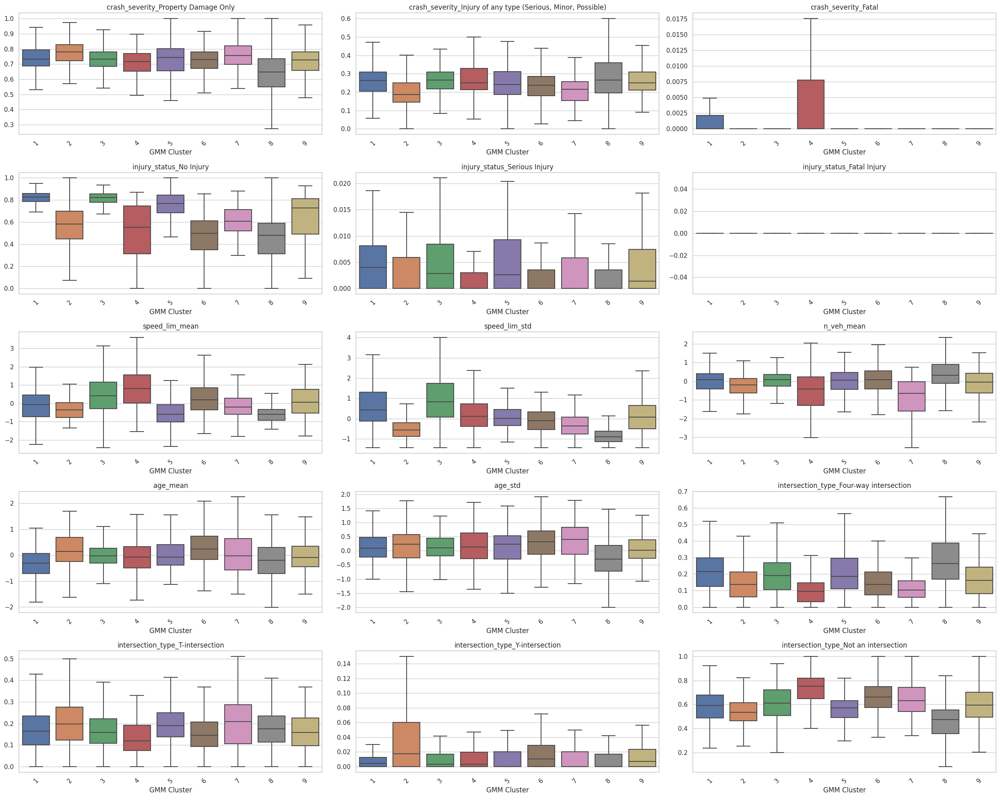

In [343]:

sns.set(style='whitegrid')


# just plot each features gmm cluster
# set a subplot for each feature with a suitable size
fig, axs = plt.subplots(5, len(selected_features)//5, figsize=(25, 20))
# now plot the boxplot for each cluster type
types = ['GMM Cluster']
for i, ax in enumerate(axs.flatten()):
    sns.boxplot(x=types[0], y=selected_features[i], data=df,
                showfliers=False, ax=ax)
    ax.set_title(selected_features[i])
    # set x-axis label
    ax.set_xlabel('GMM Cluster')
    # rotate the x-axis labels
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
    # remove y-axis label
    ax.set_ylabel('')
plt.tight_layout()
plt.show()

    

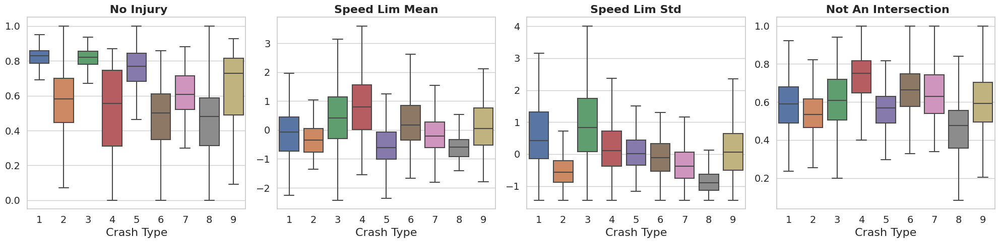

In [344]:
# Select useful features
selected_features = [
    # 'crash_severity_Property Damage Only',
    # 'crash_severity_Injury of any type (Serious, Minor, Possible)',
    # 'crash_severity_Fatal',
    'injury_status_No Injury',
    # 'injury_status_Serious Injury',
    # 'injury_status_Fatal Injury',

    'speed_lim_mean',
    'speed_lim_std',
    # 'n_veh_mean',
    # 'n_occupants_mean',
    # 'age_mean',
    # 'age_std',

    # 'intersection_type_Four-way intersection',
    # 'intersection_type_T-intersection',
    # 'intersection_type_Y-intersection',
    'intersection_type_Not an intersection',


    # 'veh_action_V1: Travelling straight ahead',
    # 'veh_action_V1: Travelling straight ahead / V2: Slowing or stopped in traffic',
    # 'veh_action_V1: Backing',
    # 'veh_action_V1: Turning left',
    # 'veh_action_V1: Entering traffic lane',
    # 'veh_action_V1: Changing lanes',
    # 'person_type_Driver',
    # # 'person_type_Occupant of a Motor Vehicle Not in Operation (parked, etc.)',
    # 'person_type_Passenger',
    # 'road_surface_1',
    # 'road_surface_2',
    # 'crash_manner_Sideswipe, same direction',
    # 'crash_manner_Rear-end',
    # 'make_Ford',
    # 'gender_Male',
    # 'gender_Female',

    ]


# # add the cluster labels to the aggregated data
# # aggregated_data['Kmeans_Cluster'] = kmeans_labels
# aggregated_data['GMM_Cluster'] = gmm_labels
# # aggregated_data['DBSCAN_Cluster'] = dbscan_labels
# # aggregated_data['Hierarchical_Cluster'] = hier_labels

# add the cluster labels to the aggregated data
# aggregated_data['Kmeans_Cluster'] = kmeans_labels
# merge with df on census_tract_id
df = pd.merge(aggregated_data, umap_df, on='census_tract_id', how='left')
df['GMM Cluster'] = gmm_labels + 1

df__ = df.copy()
# remove the underscore from the feature names and make them title case
df__.columns = df__.columns.str.replace('_', ' ').str.title()
# remove the sentences crash_severity, injury_status, intersection_type, veh_type, hour
df__.columns = df__.columns.str.replace('Crash Severity', '').str.replace('Injury Status', '').str.replace('Intersection Type', '').str.replace('Veh Type', '').str.replace('Hour', '').str.replace('Day Of Week', '')
# do the same for the selected features
selected_features = [col.replace('_', ' ').title() for col in selected_features]
# title case
selected_features = [col.title() for col in selected_features]
# remove the sentences crash_severity, injury_status, intersection_type, veh_type, hour
selected_features = [col.replace('Crash Severity', '').replace('Injury Status', '').replace('Intersection Type', '') for col in selected_features]

# bring Gmm Cluster back to GMM Cluster
df__ = df__.rename(columns={'Gmm Cluster': 'GMM Cluster'})

sns.set(style='whitegrid')


# just plot each features gmm cluster
# set a subplot for each feature with a suitable size
fig, axs = plt.subplots(1,len(selected_features), figsize=(20, 5), dpi=100)
# now plot the boxplot for each cluster type
types = ['GMM Cluster']
for i, ax in enumerate(axs.flatten()):
    sns.boxplot(x=types[0], y=selected_features[i], data=df__,
                showfliers=False, ax=ax)
    ax.set_title(selected_features[i], fontsize=16, fontweight='bold')
    # set x-axis label
    ax.set_xlabel('Crash Type', fontsize=16)
    # rotate the x-axis labels
    ax.set_xticklabels(ax.get_xticklabels(), rotation=0)
    # remove y-axis label
    ax.set_ylabel('')
    # increase tick font size
    ax.tick_params(axis='both', which='major', labelsize=14)
plt.tight_layout()
plt.show()


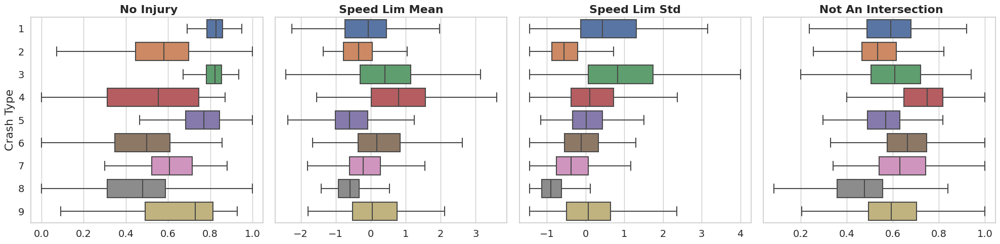

In [345]:
# Set a subplot for each feature with a suitable size
fig, axs = plt.subplots(1, len(selected_features), figsize=(20, 5), dpi=100, sharey=True)

# Now plot the boxplot for each cluster type
types = ['GMM Cluster']
for i, ax in enumerate(axs.flatten()):
    sns.boxplot(y=types[0], x=selected_features[i], data=df__,
                showfliers=False, ax=ax, orient='h')
    ax.set_title(selected_features[i], fontsize=16, fontweight='bold')
    # Set y-axis label (horizontal bars)
    # ax.set_ylabel('Crash Type', fontsize=16)
    # only set y label for the first plot
    if i == 0:
        ax.set_ylabel('Crash Type', fontsize=16)
    else:
        ax.set_ylabel('')
    # Remove x-axis label
    ax.set_xlabel('')
    # Increase tick font size
    ax.tick_params(axis='both', which='major', labelsize=14)
plt.tight_layout()
plt.show()


In [346]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

### Old
# crash_type_dict = {
#     1: "1. Urban Variable Speed",
#     2: "2. Urban/Suburban Transport/Weather",
#     3: "3. Urban High Speed",
#     4: "4. Urban/Suburban Non-Intersection",
#     5: "5. Urban Low Speed",
#     6: "6. Hybrid Non-Intersection",
#     7: "7. Rural Low Severity",
#     8: "8. Urban Intersection",
#     9: "9. Urban/Suburban Avg Speed"
# }
# cluster_names = [crash_type_dict[i+1] for i in range(9)]
# cluster_names


crash_type_dict = {
    6: 'Hybrid Non-Intersection',
    7: 'Rural Lo-Severity',
    9: 'Suburban Mid-speed',
    4: 'Suburban Non-Intersection',
    2: 'Suburban Transit Inclement',
    3: 'Urban Hi-Speed',
    8: 'Urban Intersection',
    5: 'Urban Lo-Speed',
    1: 'Urban Variable Speed'
}

# replace GMM Cluster using crash_type_dict with mapping
df__['GMM Cluster'] = df__['GMM Cluster'].map(crash_type_dict)
# sort GMM Cluster alphabetically wihtout converting to category
df__['GMM Cluster'] = df__['GMM Cluster'].astype('str')
# sort the GMM Cluster
df__= df__.sort_values(by='GMM Cluster')

df__


,Age Mean,Age Std,Census Tract Id,Fatal,"Injury Of Any Type (Serious, Minor, Possible)",Property Damage Only,1.0,2.0,3.0,4.0,...,Light Truck,Motorcycle,Other,Passenger Car,Umap1,Umap2,Umap3,Umap4,Umap5,GMM Cluster
1239,0.277794,-0.130954,25009253204,0.000000,0.277311,0.697479,0.142857,0.126050,0.142857,0.235294,...,0.084034,0.000000,0.000000,0.907563,7.951906,11.445070,10.177996,7.247451,5.483541,Hybrid Non-Intersection
1530,-0.016299,0.311426,25017331102,0.010549,0.210970,0.778481,0.151899,0.128692,0.179325,0.185654,...,0.166667,0.002110,0.004219,0.820675,8.168552,11.583030,10.134486,7.430884,5.730554,Hybrid Non-Intersection
1527,0.258997,0.700002,25017330201,0.000000,0.173913,0.818841,0.115942,0.166667,0.159420,0.195652,...,0.000000,0.000000,0.000000,0.985507,7.041823,11.583741,11.224393,7.417128,5.471377,Hybrid Non-Intersection
1526,0.424355,-0.170111,25017330102,0.032609,0.228261,0.695652,0.250000,0.173913,0.108696,0.184783,...,0.021739,0.000000,0.000000,0.967391,6.945179,11.336141,10.820637,7.324791,4.757102,Hybrid Non-Intersection
1522,-0.432835,0.219840,25017327102,0.000000,0.264368,0.712644,0.172414,0.091954,0.172414,0.103448,...,0.091954,0.022989,0.000000,0.804598,7.131617,11.757645,10.890817,7.389661,5.057995,Hybrid Non-Intersection
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
482,0.074075,0.306296,9150903200,0.006410,0.314103,0.679487,0.115385,0.083333,0.096154,0.224359,...,0.410256,0.006410,0.019231,0.532051,5.169837,9.108393,6.559914,7.107929,7.805329,Urban Variable Speed
483,-0.983045,0.230419,9150904101,0.004785,0.153110,0.842105,0.138756,0.129187,0.114833,0.110048,...,0.296651,0.014354,0.004785,0.521531,4.093478,7.736778,6.191285,8.033857,7.900579,Urban Variable Speed
486,-0.879750,0.514950,9150904500,0.000000,0.341346,0.658654,0.149038,0.245192,0.120192,0.072115,...,0.346154,0.004808,0.019231,0.495192,4.543313,7.837630,6.574286,7.312404,8.058651,Urban Variable Speed
542,-0.746116,0.260413,9170141100,0.000000,0.244094,0.755906,0.086614,0.259843,0.149606,0.141732,...,0.330709,0.007874,0.000000,0.566929,4.637678,8.116563,6.941632,6.927042,7.826599,Urban Variable Speed


In [347]:

# Assume df__ is your DataFrame and selected_features is a list of your feature names
# Melt the DataFrame to long-form for facet plotting
df_melted = pd.melt(df__, id_vars=['GMM Cluster'], value_vars=selected_features, var_name='Feature', value_name='Value')
# sort the GMM Cluster
# df_melted = df_melted.sort_values(by='GMM Cluster')
# display(df_melted)
# replce the GMM Cluster with the cluster names
# df_melted['GMM Cluster'] = df_melted['GMM Cluster'].map(lambda x: crash_type_dict[x])
# display(df_melted)
df_melted

,GMM Cluster,Feature,Value
0,Hybrid Non-Intersection,No Injury,0.815126
1,Hybrid Non-Intersection,No Injury,0.592827
2,Hybrid Non-Intersection,No Injury,0.775362
3,Hybrid Non-Intersection,No Injury,0.532609
4,Hybrid Non-Intersection,No Injury,0.505747
...,...,...,...
9915,Urban Variable Speed,Not An Intersection,0.692308
9916,Urban Variable Speed,Not An Intersection,0.564593
9917,Urban Variable Speed,Not An Intersection,0.538462
9918,Urban Variable Speed,Not An Intersection,0.566929


/home/mohammed/miniconda3/envs/oxe_dash/lib/python3.10/site-packages/seaborn/axisgrid.py:712: UserWarning:

Using the boxplot function without specifying `order` is likely to produce an incorrect plot.



<Figure size 1920x1440 with 0 Axes>

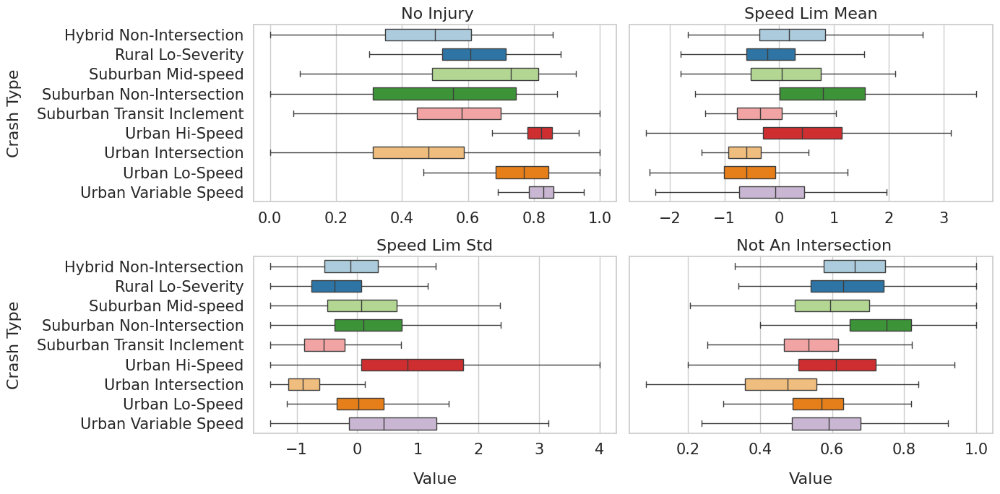

In [348]:

# Create the figure with specified DPI
fig = plt.figure(dpi=300)

# Define the FacetGrid
g = sns.FacetGrid(df_melted, col="Feature", col_wrap=2, height=3.5, aspect=2, sharey=True, sharex=False, margin_titles=True,
                  despine=False, )
# Map the boxplot to the FacetGrid with horizontal orientation
g.map(sns.boxplot, "Value", "GMM Cluster", showfliers=False, orient='h', linewidth=1, saturation=0.8, palette=qualitative_palette,
        dodge=False, width=0.6, notch=False)


# Set titles and labels with increased font size
g.set_axis_labels("Value", "Crash Type", fontsize=16, labelpad=15)

# Increase the tick label font size for both axes
for ax in g.axes.flatten():
    ax.tick_params(axis='x', labelsize=15)  # Set font size for x-axis ticks
    ax.tick_params(axis='y', labelsize=15)  # Set font size for y-axis ticks



# Set titles and labels
g.set_titles("{col_name}")

# Adjust the title font size
for ax in g.axes.flat:
    ax.set_title(ax.get_title(), fontsize=16)

# increase font size of the x and y labels
# g.set_xticklabels(fontsize=12)
# g.set_yticklabels(fontsize=12)
# Adjust the layout
g.fig.tight_layout()
plt.show()


In [349]:
df_melted

,GMM Cluster,Feature,Value
0,Hybrid Non-Intersection,No Injury,0.815126
1,Hybrid Non-Intersection,No Injury,0.592827
2,Hybrid Non-Intersection,No Injury,0.775362
3,Hybrid Non-Intersection,No Injury,0.532609
4,Hybrid Non-Intersection,No Injury,0.505747
...,...,...,...
9915,Urban Variable Speed,Not An Intersection,0.692308
9916,Urban Variable Speed,Not An Intersection,0.564593
9917,Urban Variable Speed,Not An Intersection,0.538462
9918,Urban Variable Speed,Not An Intersection,0.566929


In [350]:
# now with y = the pcs from 1 to 8
selected_features_umap = [f'UMAP{i+1}' for i in range(umap_result.shape[1])]
# rename the features to (columns={
#     'UMAP1': 'Low Severity Night Crashes',
#     'UMAP2': 'Non-Intersection Property Damage Crashes',
#     'UMAP3': 'Transit Roundabout Crashes',
#     'UMAP4': 'Adverse Weather Intersection Crashes',
#     'UMAP5': 'Variable Speed Crashes'
# })

selected_features_umap = [
    'Low Severity Night Crashes',
    'Non-Intersection Property Damage Crashes',
    'Transit Roundabout Crashes',
    'Adverse Weather Intersection Crashes',
    'Variable Speed Crashes'
]

df_tt = df.copy()

# replace GMM Cluster using crash_type_dict with mapping
df_tt['GMM Cluster'] = df_tt['GMM Cluster'].map(crash_type_dict)
# sort GMM Cluster alphabetically wihtout converting to category
df_tt['GMM Cluster'] = df_tt['GMM Cluster'].astype('str')
# sort the GMM Cluster
df_tt= df_tt.sort_values(by='GMM Cluster')

df__ = df_tt.copy()
# rename in the df__
df__ = df__.rename(columns={
    'UMAP1': 'UMAP1: Low Severity Night Crashes',
    'UMAP2': 'UMAP2: Non-Intersection Property Damage Crashes',
    'UMAP3': 'UMAP3: Transit Roundabout Crashes',
    'UMAP4': 'UMAP4: Adverse Weather Intersection Crashes',
    'UMAP5': 'UMAP5: Variable Speed Crashes'
})




sns.set(style='whitegrid')

# Selected features for the facet plot
selected_features_umap = [
    'UMAP1: Low Severity Night Crashes',
    'UMAP2: Non-Intersection Property Damage Crashes',
    'UMAP3: Transit Roundabout Crashes',
    'UMAP4: Adverse Weather Intersection Crashes',
    'UMAP5: Variable Speed Crashes'
]

# names with \n in the middle
selected_features_umap_adj = [
    'UMAP1: Low Severity\nNight Crashes',
    'UMAP2: Non-Intersection\nProperty Damage',
    'UMAP3: Public Transport \nRoundabout Crashes',
    'UMAP4: Adverse Weather \nIntersection Crashes',
    'UMAP5: Variable \nSpeed Crashes'
]

# Melt the DataFrame to long-form for facet plotting
df_melted = pd.melt(df__, id_vars=['GMM Cluster'], value_vars=selected_features_umap, var_name='Feature', value_name='Value')

# # Replace the GMM Cluster with the cluster names
# df_melted['GMM Cluster'] = df_melted['GMM Cluster'].map(lambda x: crash_type_dict[x])
# sort the GMM Cluster
# df_melted = df_melted.sort_values(by='GMM Cluster')
df_melted


,GMM Cluster,Feature,Value
0,Hybrid Non-Intersection,UMAP1: Low Severity Night Crashes,7.951906
1,Hybrid Non-Intersection,UMAP1: Low Severity Night Crashes,8.168552
2,Hybrid Non-Intersection,UMAP1: Low Severity Night Crashes,7.041823
3,Hybrid Non-Intersection,UMAP1: Low Severity Night Crashes,6.945179
4,Hybrid Non-Intersection,UMAP1: Low Severity Night Crashes,7.131617
...,...,...,...
12395,Urban Variable Speed,UMAP5: Variable Speed Crashes,7.805329
12396,Urban Variable Speed,UMAP5: Variable Speed Crashes,7.900579
12397,Urban Variable Speed,UMAP5: Variable Speed Crashes,8.058651
12398,Urban Variable Speed,UMAP5: Variable Speed Crashes,7.826599


/home/mohammed/miniconda3/envs/oxe_dash/lib/python3.10/site-packages/seaborn/axisgrid.py:712: UserWarning:

Using the boxplot function without specifying `order` is likely to produce an incorrect plot.



<Figure size 1920x1440 with 0 Axes>

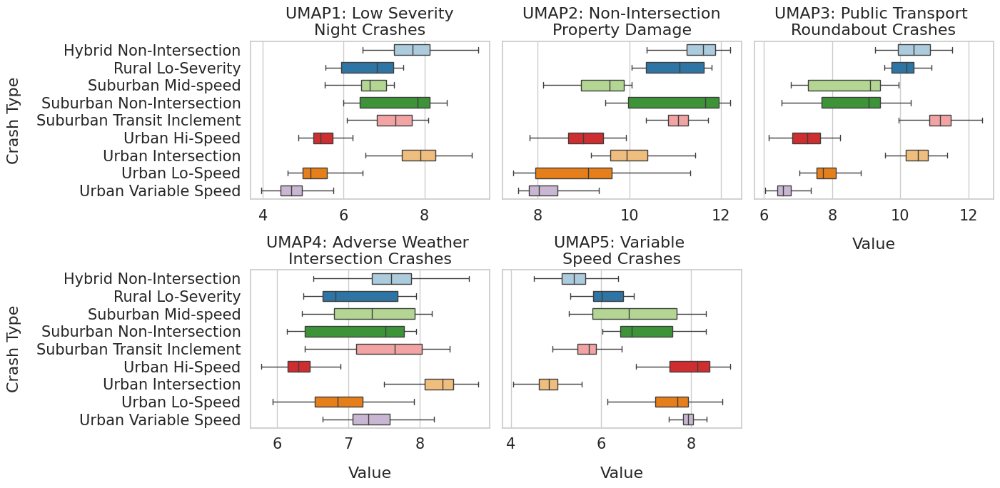

In [351]:

# Create the figure with specified DPI
fig = plt.figure(dpi=300)

# Define the FacetGrid
g = sns.FacetGrid(df_melted, col="Feature", col_wrap=3, height=3.5, aspect=1.35, sharey=True, sharex=False, margin_titles=True, despine=False)

# Map the boxplot to the FacetGrid with horizontal orientation
g.map(sns.boxplot, "Value", "GMM Cluster", showfliers=False, orient='h', linewidth=1, saturation=0.8, dodge=False, width=0.6, notch=False, palette=qualitative_palette)

# Set titles and labels with increased font size
g.set_axis_labels("Value", "Crash Type", fontsize=16, labelpad=15)

# Increase the tick label font size for both axes
for ax in g.axes.flatten():
    ax.tick_params(axis='x', labelsize=15)  # Set font size for x-axis ticks
    ax.tick_params(axis='y', labelsize=15)  # Set font size for y-axis ticks

# Set titles and labels
# g.set_titles("{col_name}")

# set with the adjusted names
for ax, title in zip(g.axes.flat, selected_features_umap_adj):
    ax.set_title(title, fontsize=16, fontweight='bold')

# Adjust the title font size
for ax in g.axes.flat:
    ax.set_title(ax.get_title(), fontsize=16)

# Adjust the layout
g.fig.tight_layout()
plt.show()


In [352]:

# # plot cluster in x axis vs umap in y axis in one plot
# # Melt the DataFrame
# df_melted = pd.melt(df, id_vars=['GMM Cluster'], value_vars=selected_features_umap, var_name='Component', value_name='UMAP Value')
# # Plot the data
# plt.figure(figsize=(16, 5), dpi=100)
# sns.boxplot(x='GMM Cluster', y='UMAP Value', hue='Component', data=df_melted, showfliers=False, palette='muted', linewidth=1)
# # add x grid on the 0.5 marks (1.5, 2.5, 3.5, 4.5)
# # plt.xticks([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5], [1, 2, 3, 4, 5, 6, 7, 8, 9])
# # plt.grid(axis='x', which='major', color='black', linestyle='--', linewidth=0.5)
# # add vertical lines at 0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5
# for i in range(1, 9):
#     plt.axvline(x=i - 0.5, color='black', linestyle='--', linewidth=0.5)


# # set X and Y axis label
# plt.xlabel('Type')
# plt.ylabel('UMAP Value')



# # plt.title('UMAP Components by GMM Cluster')
# plt.tight_layout()
# plt.show()




# Plot maps

In [353]:
# import pandas as pd
# from census import Census
# from us import states
# import requests
# import geopandas as gpd
# import matplotlib.pyplot as plt
# from shapely.geometry import shape

# import requests
# import geopandas as gpd
# import pandas as pd
# from shapely.geometry import shape
# from concurrent.futures import ThreadPoolExecutor


# df_ =  df.copy()
# # df = aggregated_data.copy()
# # convert GMM_Cluster to string
# df_['GMM Cluster'] = df_['GMM Cluster'].astype(str)

# df_ = pd.merge(df_, unique_tracts_df, on='census_tract_id', how='left')

# # Convert DataFrame to GeoDataFrame and plot
# gdf = gpd.GeoDataFrame(df_, geometry='census_tract_geometry')

# # get the muted color palette in list form
# map_palette = sns.color_palette('muted')
# # convert to dict with 1: color, 2: color, etc
# map_palette = {str(i +1): map_palette[i] for i in range(len(map_palette))}

# # # add a column called palette to the gdf with the color for each cluster
# gdf['palette'] = gdf['GMM Cluster'].map(map_palette)



# from matplotlib import patches as mpatches

# # use this palette as the cmap below
# cmap = sns.color_palette('muted', as_cmap=True)
# # print
# # print('Starting to plot')
# gdf.plot(column='GMM Cluster', figsize=(20, 10), legend=True,
#             # cmap='tab10',
#             color=gdf['palette'],
#             # add label
#             # legend_kwds={'loc': 'upper left', 'bbox_to_anchor': (1, 1), 'title': 'GMM Cluster', 'labels': [f'Cluster {i+1}' for i in range(9)]},
#             edgecolor='black', 
#             linewidth=1)



# # ValueError: 'Pastel3' is not a valid value for cmap; supported values are 'Accent', 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 
# # 'BrBG_r', 'BuGn', 'BuGn_r', 'BuPu', 'BuPu_r', 'CMRmap', 'CMRmap_r', 'Dark2', 'Dark2_r', 'GnBu', 'GnBu_r', 'Greens', 'Greens_r', 
# # 'Greys', 'Greys_r', 'OrRd', 'OrRd_r', 'Oranges', 'Oranges_r', 'PRGn', 'PRGn_r', 'Paired', 'Paired_r', 'Pastel1', 'Pastel1_r', 'Pastel2', 
# # 'Pastel2_r', 'PiYG', 'PiYG_r', 'PuBu', 'PuBuGn', 'PuBuGn_r', 'PuBu_r', 'PuOr', 'PuOr_r', 'PuRd', 'PuRd_r', 'Purples', 'Purples_r', 'RdBu', 
# # 'RdBu_r', 'RdGy', 'RdGy_r', 'RdPu', 'RdPu_r', 'RdYlBu', 'RdYlBu_r', 'RdYlGn', 'RdYlGn_r', 'Reds', 'Reds_r', 'Set1', 'Set1_r', 'Set2', 'Set2_r', 
# # 'Set3', 'Set3_r', 'Spectral', 'Spectral_r', 'Wistia', 'Wistia_r', 'YlGn', 'YlGnBu', 'YlGnBu_r', 'YlGn_r', 'YlOrBr', 'YlOrBr_r', 'YlOrRd', 'YlOrRd_r', 
# # 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'bwr_r', 'cividis', 'cividis_r', 'cool', 
# # 'cool_r', 'coolwarm', 'coolwarm_r', 'copper', 'copper_r', 'crest', 'crest_r', 'cubehelix', 'cubehelix_r', 'flag', 'flag_r', 'flare', 'flare_r', 'gist_earth', 
# # 'gist_earth_r', 'gist_gray', 'gist_gray_r', 'gist_heat', 'gist_heat_r', 'gist_ncar', 'gist_ncar_r', 'gist_rainbow', 'gist_rainbow_r', 'gist_stern', 'gist_stern_r', 
# # 'gist_yarg', 'gist_yarg_r', 'gnuplot', 'gnuplot2', 'gnuplot2_r', 'gnuplot_r', 'gray', 'gray_r', 'hot', 'hot_r', 'hsv', 'hsv_r', 'icefire', 'icefire_r', 'inferno', 
# # 'inferno_r', 'jet', 'jet_r', 'magma', 'magma_r', 'mako', 'mako_r', 'nipy_spectral', 'nipy_spectral_r', 'ocean', 'ocean_r', 'pink', 'pink_r', 'plasma', 'plasma_r',
# #  'prism', 'prism_r', 'rainbow', 'rainbow_r', 'rocket', 'rocket_r', 'seismic', 'seismic_r', 'spring', 'spring_r', 'summer', 'summer_r', 'tab10', 'tab10_r', 'tab20', 
# # 'tab20_r', 'tab20b', 'tab20b_r', 'tab20c', 'tab20c_r', 'terrain', 'terrain_r', 'turbo', 'turbo_r', 'twilight', 'twilight_r', 'twilight_shifted', 'twilight_shifted_r',
# #  'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r'



# # Create custom legend
# legend_patches = [mpatches.Patch(color=palette[i], label=f'Cluster {i+1}') for i in range(9)]
# ax.legend(handles=legend_patches, loc='upper left', bbox_to_anchor=(1, 1), title='GMM Cluster')



# # #  remove axis
# plt.axis('off')
# plt.show()


# Analyze the spatial distribution of clusters


To provide a more detailed analysis of each cluster, we'll break down the occurrences of each cluster by county and urban area, and categorize these areas as urban, town, or rural based on general knowledge and available data.

Step-by-Step Analysis:
Cluster 1:

Predominantly appears in "Hartford, CT Urban Area" and other urban areas.
This suggests Cluster 1 is highly associated with urban regions.
Cluster 2:

[Analysis based on its appearance in the dataset].
Cluster 3:

[Analysis based on its appearance in the dataset].
Cluster 4:

[Analysis based on its appearance in the dataset].
Cluster 5:

[Analysis based on its appearance in the dataset].
Let's perform this detailed analysis by examining the dataset more closely.

Code for Detailed Analysis


In [189]:
df_ = df__.copy()
# add the county and urban to the df. dont remove or add any rows to the df
df_ = pd.merge(df_, unique_tracts_county_urban_df, on='census_tract_id', how='left')
     
df_
# # only  keep the cluster, the county and the urban columns
df_ = df_[['GMM Cluster', 'county_name', 'urban_area_name', 'census_tract_id']]
data = df_.copy()
data


,GMM Cluster,county_name,urban_area_name,census_tract_id
0,Hybrid Non-Intersection,Essex County,"Boston, MA--NH Urban Area",25009253204
1,Hybrid Non-Intersection,Middlesex County,"Boston, MA--NH Urban Area",25017331102
2,Hybrid Non-Intersection,Middlesex County,"Boston, MA--NH Urban Area",25017330201
3,Hybrid Non-Intersection,Middlesex County,"Boston, MA--NH Urban Area",25017330102
4,Hybrid Non-Intersection,Middlesex County,"Pepperell, MA Urban Area",25017327102
...,...,...,...,...
2517,Urban Variable Speed,Northeastern Connecticut Planning Region,"Putnam--Killingly, CT Urban Area",9150903200
2518,Urban Variable Speed,Northeastern Connecticut Planning Region,"Putnam--Killingly, CT Urban Area",9150904101
2519,Urban Variable Speed,Northeastern Connecticut Planning Region,"Putnam--Killingly, CT Urban Area",9150904500
2520,Urban Variable Speed,South Central Connecticut Planning Region,"New Haven, CT Urban Area",9170141100


/tmp/ipykernel_3701303/133374831.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Area Type,Rural,Town,Urban
GMM Cluster,,,
Hybrid Non-Intersection,111,58,103
Rural Lo-Severity,12,4,4
Suburban Mid-speed,23,16,39
Suburban Non-Intersection,12,16,32
Suburban Transit Inclement,28,23,37
Urban Hi-Speed,28,78,338
Urban Intersection,11,29,68
Urban Lo-Speed,16,30,106
Urban Variable Speed,18,29,146


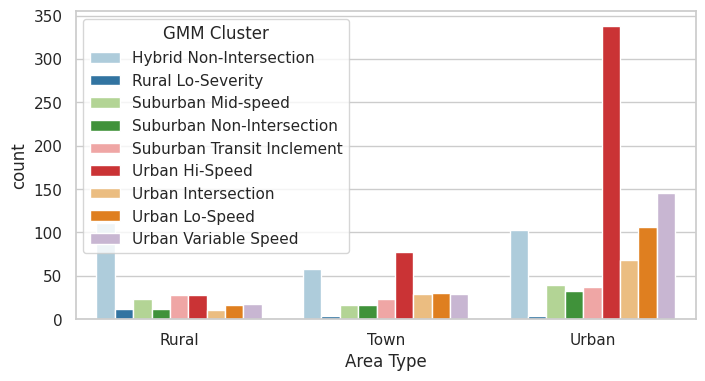

In [191]:
# Create a function to categorize urban areas, towns, and rural areas
def categorize_area(urban_area_name):
    # urban_areas = ['Hartford, CT Urban Area', 'Boston, MA--NH Urban Area', 'Providence, RI--MA Urban Area', 'Springfield, MA--CT Urban Area', 'New Haven, CT Urban Area', 'Stamford, CT Urban Area', 'Bridgeport, CT Urban Area']
    # towns = ['Barnstable Town, MA Urban Area', 'Worcester, MA--CT Urban Area', 'Waterbury, CT Urban Area', 'Norwich--New London, CT Urban Area']
    # rural_areas = ['Storrs, CT Urban Area']
    # urban_areas = [
    #     'Hartford, CT Urban Area', 'Springfield, MA--CT Urban Area', 
    #     'Bridgeport--Stamford, CT--NY Urban Area', 'New Haven, CT Urban Area', 
    #     'Worcester, MA--CT Urban Area', 'Boston, MA--NH Urban Area', 
    #     'Providence, RI--MA Urban Area', 'Danbury, CT--NY Urban Area'
    # ]
    # rural_areas = [
    #     'Willimantic, CT Urban Area', 'Waterbury, CT Urban Area', 
    #     'Torrington, CT Urban Area', 'Norwich--New London, CT Urban Area', 
    #     'Winsted, CT Urban Area', 'Southbridge Town, MA Urban Area', 
    #     'Leominster--Fitchburg, MA Urban Area', 
    #     'Amherst Town--Northampton--Easthampton Town, MA Urban Area', 
    #     'New Bedford, MA Urban Area'
    # ]
    # rural_areas = [
    #     'Storrs, CT Urban Area', 'Stafford Springs, CT Urban Area', 
    #     'Lake Pocotopaug, CT Urban Area', 'Ridgefield, CT Urban Area', 
    #     'Provincetown, MA Urban Area', 'Barnstable Town, MA Urban Area', 
    #     'Pittsfield, MA Urban Area', 'Lee, MA Urban Area', 
    #     'North Adams, MA Urban Area', 'Vineyard Haven--Edgartown--Oak Bluffs, MA Urban Area', 
    #     'Ipswich, MA Urban Area', 'Greenfield, MA Urban Area', 
    #     'Athol, MA Urban Area', 'Sunderland--South Deerfield, MA Urban Area', 
    #     'Ware, MA Urban Area', 'Pepperell, MA Urban Area', 
    #     'Nantucket, MA Urban Area', 'Winchendon, MA Urban Area', 
    #     'Spencer, MA Urban Area'
    # ]

    urban_areas = [
        'Hartford, CT Urban Area', 'Springfield, MA--CT Urban Area', 
         'New Haven, CT Urban Area', 'Bridgeport--Stamford, CT--NY Urban Area','Providence, RI--MA Urban Area', 'New Bedford, MA Urban Area'
         
        #  'Boston, MA--NH Urban Area',
    ]
    towns = [ # was towns
        ## towns
        'Worcester, MA--CT Urban Area', 'Waterbury, CT Urban Area', 
        'Norwich--New London, CT Urban Area', 'Danbury, CT--NY Urban Area', 
        'Amherst Town--Northampton--Easthampton Town, MA Urban Area'
        ###
    ]
    rural_areas = [
        
        'Storrs, CT Urban Area', 'Willimantic, CT Urban Area', 
        'Stafford Springs, CT Urban Area', 'Lake Pocotopaug, CT Urban Area', 
        'Putnam--Killingly, CT Urban Area', 'Winsted, CT Urban Area', 
        'Torrington, CT Urban Area', 'Westerly, RI--CT Urban Area', 
        'Jewett City, CT Urban Area', 'Colchester, CT Urban Area', 
        'Ridgefield, CT Urban Area', 'Provincetown, MA Urban Area', 
        'Barnstable Town, MA Urban Area', 'Pittsfield, MA Urban Area', 
        'Lee, MA Urban Area', 'North Adams, MA Urban Area', 
        'Vineyard Haven--Edgartown--Oak Bluffs, MA Urban Area', 
        'Ipswich, MA Urban Area', 'Greenfield, MA Urban Area', 
        'Athol, MA Urban Area', 'Sunderland--South Deerfield, MA Urban Area', 
        'Ware, MA Urban Area', 'Pepperell, MA Urban Area', 
        'Nashua, NH--MA Urban Area', 'Leominster--Fitchburg, MA Urban Area', 
        'Nantucket, MA Urban Area', 'Winchendon, MA Urban Area', 
        'Spencer, MA Urban Area', 'Southbridge Town, MA Urban Area'
    ]
    
    
    if urban_area_name in urban_areas:
        return 'Urban'
    elif urban_area_name in towns:
        return 'Town'
    elif urban_area_name in rural_areas:
        return 'Rural'
    else:
        return 'Unknown'

# Apply the categorization to the dataset
data['Area Type'] = data['urban_area_name'].apply(categorize_area)

# remove unknown
data = data[data['Area Type'] != 'Unknown']

# Summarize the clusters by area type
cluster_summary = data.groupby(['GMM Cluster', 'Area Type']).size().reset_index(name='count')

# Display the summary for interpretation
display(cluster_summary.pivot(index='GMM Cluster', columns='Area Type', values='count'))
# Visualize the distribution of clusters by area type
plt.figure(figsize=(8, 4))
sns.countplot(data=data, x='Area Type', hue='GMM Cluster', palette=qualitative_palette)
# plt.title('Distribution of GMM Clusters by Area Type')
# plt.grid(axis='y')
plt.show()


# Calculate the percentage distribution of clusters by area type
percentage_summary = data.groupby(['GMM Cluster', 'Area Type']).size().unstack(fill_value=0)
percentage_summary = percentage_summary.div(percentage_summary.sum(axis=1), axis=0) * 100



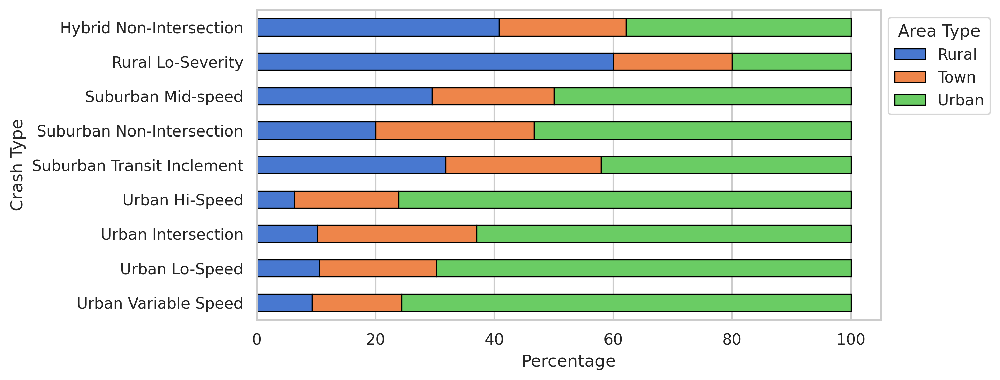

Area Type,Rural,Town,Urban
GMM Cluster,,,
Hybrid Non-Intersection,40.808824,21.323529,37.867647
Rural Lo-Severity,60.000000,20.000000,20.000000
Suburban Mid-speed,29.487179,20.512821,50.000000
Suburban Non-Intersection,20.000000,26.666667,53.333333
Suburban Transit Inclement,31.818182,26.136364,42.045455
Urban Hi-Speed,6.306306,17.567568,76.126126
Urban Intersection,10.185185,26.851852,62.962963
Urban Lo-Speed,10.526316,19.736842,69.736842
Urban Variable Speed,9.326425,15.025907,75.647668


In [354]:

# set dpi = 300
# Create the figure and axes with the desired DPI
fig, ax = plt.subplots(figsize=(8, 4), dpi=300)

# Plot the percentage stacked bar chart
percentage_summary.plot(kind='barh', stacked=True, ax=ax, edgecolor='black', linewidth=0.8, color=sns.color_palette('muted', n_colors=3))
# plt.title('Percentage Distribution of GMM Clusters by Area Type')
plt.ylabel('Crash Type')
plt.xlabel('Percentage')
plt.legend(title='Area Type', bbox_to_anchor=(1, 1), loc='upper left')
plt.grid(axis='y')
# rotate the x-axis labels
plt.xticks(rotation=0)

crash_type_dict = {
    6: 'Hybrid Non-Intersection',
    7: 'Rural Lo-Severity',
    9: 'Suburban Mid-speed',
    4: 'Suburban Non-Intersection',
    2: 'Suburban Transit Inclement',
    3: 'Urban Hi-Speed',
    8: 'Urban Intersection',
    5: 'Urban Lo-Speed',
    1: 'Urban Variable Speed'
}


# cluster_names = [crash_type_dict[i+1] for i in range(9)]
# # add 1., 2., 3., etc to the cluster names
# cluster_names = [f'{i+1}. {cluster_names[i]}' for i in range(9)]



# set the xticks
# plt.yticks(range(9), cluster_names)
# reverse the y-axis
plt.gca().invert_yaxis()

# increase y axis font size
# plt.yticks(fontsize=10)
# plt.xticks(fontsize=10)

plt.show()


percentage_summary

In [196]:
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
import pandas as pd

# List of major cities/towns with their coordinates
cities_towns = {
    'City': [
        'Boston', 'Worcester', 'Springfield', 'Lowell', 'Cambridge', 'Brockton', 'New Bedford', 'Quincy', 'Lynn', 'Fall River',
        'Hartford', 'New Haven', 'Stamford', 'Waterbury', 'Bridgeport', 'Norwalk', 'Danbury', 'New Britain', 'West Hartford', 'Greenwich',
        'Somerville', 'Lawrence', 'Framingham', 'Haverhill', 'Waltham', 'Malden', 'Brookline', 'Medford', 'Taunton', 'Chicopee',
        'Meriden', 'Bristol', 'West Haven', 'Milford', 'Middletown', 'Shelton', 'Norwich', 'Torrington', 'Naugatuck', 'New London'
    ],
    'State': [
        'MA', 'MA', 'MA', 'MA', 'MA', 'MA', 'MA', 'MA', 'MA', 'MA',
        'CT', 'CT', 'CT', 'CT', 'CT', 'CT', 'CT', 'CT', 'CT', 'CT',
        'MA', 'MA', 'MA', 'MA', 'MA', 'MA', 'MA', 'MA', 'MA', 'MA',
        'CT', 'CT', 'CT', 'CT', 'CT', 'CT', 'CT', 'CT', 'CT', 'CT'
    ],
    'Latitude': [
        42.3601, 42.2626, 42.1015, 42.6334, 42.3736, 42.0834, 41.6362, 42.2529, 42.4668, 41.7015,
        41.7637, 41.3083, 41.0534, 41.5582, 41.1865, 41.1177, 41.3948, 41.6612, 41.7620, 41.0265,
        42.3876, 42.7070, 42.2793, 42.7762, 42.3765, 42.4251, 42.3314, 42.4184, 41.9001, 42.1487,
        41.5382, 41.6718, 41.2707, 41.2307, 41.5623, 41.3165, 41.5243, 41.8007, 41.4851, 41.3557
    ],
    'Longitude': [
        -71.0589, -71.8023, -72.5898, -71.3162, -71.1097, -71.0184, -70.9342, -71.0023, -70.9495, -71.1550,
        -72.6851, -72.9279, -73.5387, -73.0515, -73.1952, -73.4082, -73.4540, -72.7795, -72.7420, -73.6282,
        -71.0995, -71.1631, -71.4162, -71.0773, -71.2358, -71.0662, -71.1212, -71.1097, -71.0898, -72.6070,
        -72.8070, -72.9493, -72.9470, -73.0640, -72.6507, -73.0932, -72.0759, -73.1212, -73.0505, -72.0995
    ]
}

# Create a DataFrame
cities_towns = pd.DataFrame(cities_towns)

In [54]:
! pip install geopandas contextily


/bin/bash: /home/mohammed/miniconda3/envs/oxe_dash/lib/python3.10/site-packages/cv2/../../../../lib/libtinfo.so.6: no version information available (required by /bin/bash)


In [197]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Load the state boundaries from Natural Earth
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
# Filter for USA states
usa = world[(world.name == "United States of America")]

# Get the state boundaries for Massachusetts and Connecticut
states = gpd.read_file('https://raw.githubusercontent.com/PublicaMundi/MappingAPI/master/data/geojson/us-states.json')
ma_ct = states[(states['name'] == 'Massachusetts') | (states['name'] == 'Connecticut')]

In [204]:
gdf

,age_mean,age_std,census_tract_id,crash_severity_Fatal,"crash_severity_Injury of any type (Serious, Minor, Possible)",crash_severity_Property Damage Only,day_of_week_1.0,day_of_week_2.0,day_of_week_3.0,day_of_week_4.0,...,veh_type_Motorcycle,veh_type_Other,veh_type_Passenger Car,UMAP1: Low Severity Night Crashes,UMAP2: Non-Intersection Property Damage Crashes,UMAP3: Transit Roundabout Crashes,UMAP4: Adverse Weather Intersection Crashes,UMAP5: Variable Speed Crashes,GMM Cluster,census_tract_geometry
0,0.277794,-0.130954,25009253204,0.000000,0.277311,0.697479,0.142857,0.126050,0.142857,0.235294,...,0.000000,0.000000,0.907563,7.951906,11.445070,10.177996,7.247451,5.483541,Hybrid Non-Intersection,"POLYGON ((-71.09322 42.62708, -71.09326 42.626..."
1,-0.016299,0.311426,25017331102,0.010549,0.210970,0.778481,0.151899,0.128692,0.179325,0.185654,...,0.002110,0.004219,0.820675,8.168552,11.583030,10.134486,7.430884,5.730554,Hybrid Non-Intersection,"POLYGON ((-71.15202 42.57718, -71.15226 42.577..."
2,0.258997,0.700002,25017330201,0.000000,0.173913,0.818841,0.115942,0.166667,0.159420,0.195652,...,0.000000,0.000000,0.985507,7.041823,11.583741,11.224393,7.417128,5.471377,Hybrid Non-Intersection,"POLYGON ((-71.12136 42.60028, -71.12134 42.600..."
3,0.424355,-0.170111,25017330102,0.032609,0.228261,0.695652,0.250000,0.173913,0.108696,0.184783,...,0.000000,0.000000,0.967391,6.945179,11.336141,10.820637,7.324791,4.757102,Hybrid Non-Intersection,"POLYGON ((-71.09282 42.55927, -71.09278 42.559..."
4,-0.432835,0.219840,25017327102,0.000000,0.264368,0.712644,0.172414,0.091954,0.172414,0.103448,...,0.022989,0.000000,0.804598,7.131617,11.757645,10.890817,7.389661,5.057995,Hybrid Non-Intersection,"POLYGON ((-71.57927 42.65756, -71.57961 42.656..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2475,0.074075,0.306296,9150903200,0.006410,0.314103,0.679487,0.115385,0.083333,0.096154,0.224359,...,0.006410,0.019231,0.532051,5.169837,9.108393,6.559914,7.107929,7.805329,Urban Variable Speed,"POLYGON ((-71.93367 41.91687, -71.93385 41.916..."
2476,-0.983045,0.230419,9150904101,0.004785,0.153110,0.842105,0.138756,0.129187,0.114833,0.110048,...,0.014354,0.004785,0.521531,4.093478,7.736778,6.191285,8.033857,7.900579,Urban Variable Speed,"POLYGON ((-71.89600 41.88120, -71.89596 41.880..."
2477,-0.879750,0.514950,9150904500,0.000000,0.341346,0.658654,0.149038,0.245192,0.120192,0.072115,...,0.004808,0.019231,0.495192,4.543313,7.837630,6.574286,7.312404,8.058651,Urban Variable Speed,"POLYGON ((-71.89920 41.80843, -71.89926 41.807..."
2478,-0.746116,0.260413,9170141100,0.000000,0.244094,0.755906,0.086614,0.259843,0.149606,0.141732,...,0.007874,0.000000,0.566929,4.637678,8.116563,6.941632,6.927042,7.826599,Urban Variable Speed,"POLYGON ((-72.99786 41.31572, -72.99805 41.314..."


In [356]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.patches import Patch

# Copy the DataFrame
df_ = df__.copy()

# Convert GMM Cluster to string
df_['GMM Cluster'] = df_['GMM Cluster'].astype(str)

# Merge DataFrames
df_ = pd.merge(df_, unique_tracts_df, on='census_tract_id', how='left')

# Convert DataFrame to GeoDataFrame
gdf = gpd.GeoDataFrame(df_, geometry='census_tract_geometry')

# Get the muted color palette in list form
# map_palette = sns.color_palette('muted')
# Convert to dict with '1': color, '2': color, etc
# map_palette = {str(i + 1): map_palette[i] for i in range(len(map_palette))}
# remove the last number
# map_palette.pop('10', None)
# map_palette
map_palette = qualitative_palette
# Add a column called palette to the gdf with the color for each cluster


map_legend_dict= {
    1: 'Hybrid Non-Intersection',
    2: 'Rural Lo-Severity',
    3: 'Suburban Mid-speed',
    4: 'Suburban Non-Intersection',
    5: 'Suburban Transit Inclement',
    6: 'Urban Hi-Speed',
    7: 'Urban Intersection',
    8: 'Urban Lo-Speed',
    9: 'Urban Variable Speed'
}
cluster_names = [map_legend_dict[i+1] for i in range(9)]

# create a dict with the crash type and the color
map_palette = {map_legend_dict[i+1]: qualitative_palette[i] for i in range(9)}
map_palette


gdf['palette'] = gdf['GMM Cluster'].map(map_palette)


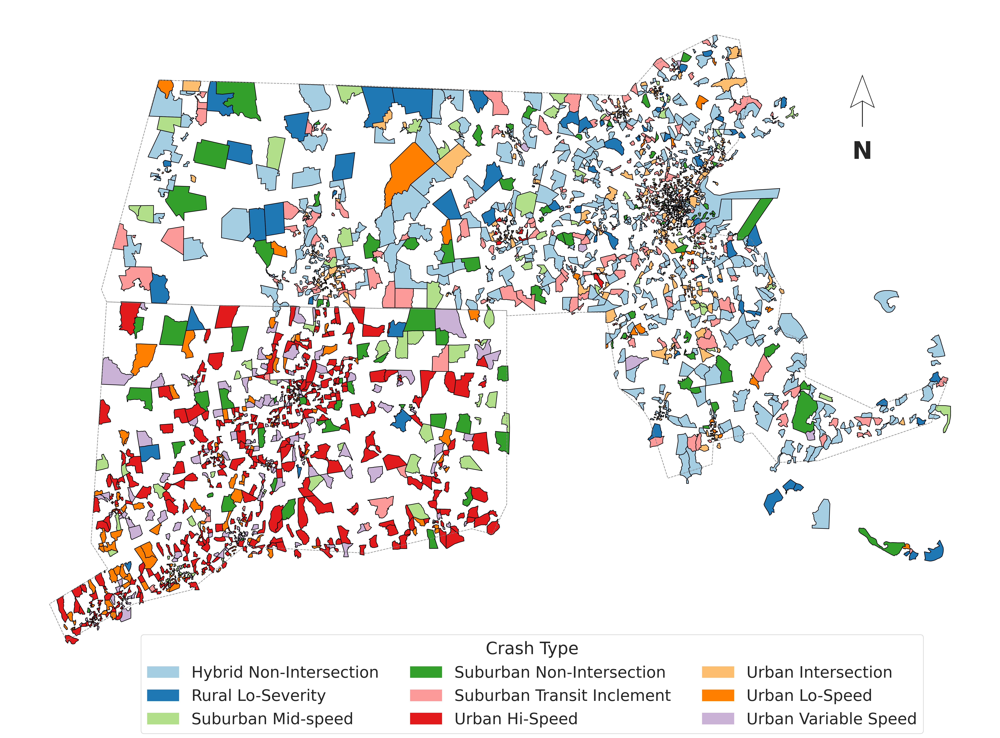

In [357]:



# Plot the GeoDataFrame
# set dpi to 300
# Create the figure and axes with the desired DPI
fig, ax = plt.subplots(figsize=(40, 20), dpi=300)
gdf.plot(edgecolor='black', linewidth=1, figsize=(40, 20), ax=ax, color=gdf['palette'])

# Plot the state boundaries on top
ma_ct.boundary.plot(ax=ax, edgecolor='grey', linewidth=1, linestyle='--', alpha=0.9,)


# Create custom legend
legend_patches = [Patch(color=color, label=f'{i+1}') for i, color in enumerate(map_palette.values())]


# plt.legend(handles=legend_patches, loc='upper left', bbox_to_anchor=(1, 1), title='Crash Type', title_fontsize='18', fontsize='16')
# make legend horizontal and with 3 columns
plt.legend(handles=legend_patches, loc='lower left', bbox_to_anchor=(0.13, -0.1), title='Crash Type', title_fontsize='28', fontsize='26', ncol=3,
            # replace the legend names from 1, 2, 3, 4, 5, 6, 7, 8, 9 to names in cluster_names
            labels=[name for name in cluster_names]
            )


# Add north arrow
x, y = -70.3, 42.6
# plt.arrow(x, y, 0, 0.1, head_width=0.1, head_length=0.1, fc='k', ec='k')
# plt.text(x, y + 0.15, 'N', ha='center', va='center', fontsize=16)
# make the arrow white with black border and shorter
plt.arrow(x, y, 0, 0.06, head_width=0.1, head_length=0.1, fc='w', ec='k', lw=1, ls='-', zorder=10,
        # increase edge width
            overhang=0.2,
            # increase thickness
            linewidth=10,)
plt.text(x, y - 0.08, 'N', ha='center', va='center', fontsize=40, fontweight='bold')


# Remove axis
plt.axis('off')
plt.show()




In [58]:
legend_patches

# Prediction Model Development

In [59]:
selected_features_umap

['UMAP1: Low Severity Night Crashes',
 'UMAP2: Non-Intersection Property Damage',
 'UMAP3: Public Transport Roundabout Crashes',
 'UMAP4: Adverse Weather Intersection Crashes',
 'UMAP5: Variable Speed Crashes']

In [244]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
# import grid search (GridSearchCV)
from sklearn.model_selection import GridSearchCV


# Define features and target
# X = df.drop(columns=['census_tract_id', 'GMM Cluster', 'UMAP1', 'UMAP2', 'UMAP3', 'UMAP4', 'UMAP5'])
# JUST MAKE IT THE umaps
X = df[['UMAP1', 'UMAP2', 'UMAP3', 'UMAP4', 'UMAP5']]
y = df['GMM Cluster']

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define the parameter grid for GridSearchCV
param_grid = {
    'n_estimators': [50, 100, 150],
    'max_depth': [None, 5, 10, 15,],
    'min_samples_split': [2, 5, 10, 15],
    'min_samples_leaf': [1, 2, 4, 8],
    'bootstrap': [True, False],
    # 'criterion': ['gini', 'entropy']
}

# Create a RandomForestClassifier
rf = RandomForestClassifier(random_state=0)

# Set up the GridSearchCV with parallelization
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, 
                            cv=5, n_jobs=-1, verbose=2, scoring='accuracy')



# Fit the grid search to the data
grid_search.fit(X_train, y_train)



# Print the best parameters and best score
print("Best parameters found: ", grid_search.best_params_)
print("Best cross-validation score: ", grid_search.best_score_)

# Predict on the test set using the best found model
best_rf_model = grid_search.best_estimator_
y_pred = best_rf_model.predict(X_test)

# Evaluate model performance
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

# Save the best model
joblib.dump(best_rf_model, 'best_rf_model2.pkl')

Fitting 5 folds for each of 384 candidates, totalling 1920 fits


[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=50; total time=   0.1s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=5, n_estimators=50; total time=   0.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total time=   0.4s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=50; total time=   0.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=50; total time=   0.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=50; total time=   0.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=50; total time=   0.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=5, n_estimators=50; total time=   0.2s
[CV] END bootstrap=True, max_depth=None, min_samples_le

['best_rf_model2.pkl']

In [245]:
# save grid search results to a dataframe
results = pd.DataFrame(grid_search.cv_results_)

# convert to clear readable format
results = results[['param_n_estimators', 'param_max_depth', 'param_min_samples_split', 'param_min_samples_leaf', 'param_bootstrap', 'mean_test_score', 'rank_test_score']]
results = results.sort_values(by='rank_test_score')
# rename columns with correct score name to accuracy
results.columns = ['n_estimators', 'max_depth', 'min_samples_split', 'min_samples_leaf', 'bootstrap', 'accuracy', 'rank']
results = results.replace({None: 'None'})
# aggregate on n_estimators and max_depth
results = results.groupby(['n_estimators', 'max_depth', 'min_samples_split', 'min_samples_leaf']).agg({'accuracy': 'mean', 'rank': 'min'}).reset_index()
results#.to_csv('grid_search_results.csv', index=False)
results_df = results.copy()
# replace None with 'None'

results_df
# results_df.max_depth.unique()

,n_estimators,max_depth,min_samples_split,min_samples_leaf,accuracy,rank
0,50,5,2,1,0.894404,331
1,50,5,2,2,0.895159,322
2,50,5,2,4,0.894151,320
3,50,5,2,8,0.887851,377
4,50,5,5,1,0.894402,333
...,...,...,...,...,...,...
187,150,None,10,8,0.927923,225
188,150,None,15,1,0.936745,98
189,150,None,15,2,0.934980,98
190,150,None,15,4,0.932461,181


In [62]:
# results_df
# # rename col min samples leaf to $$m_{\min}$$
# results_df = results_df.rename(columns={'min_samples_leaf': r'$m_{\min}$'})
# results_df

In [63]:
print(r'$m_{\min}$')

$m_{\min}$


/tmp/ipykernel_3701303/1410455767.py:73: UserWarning:

The figure layout has changed to tight



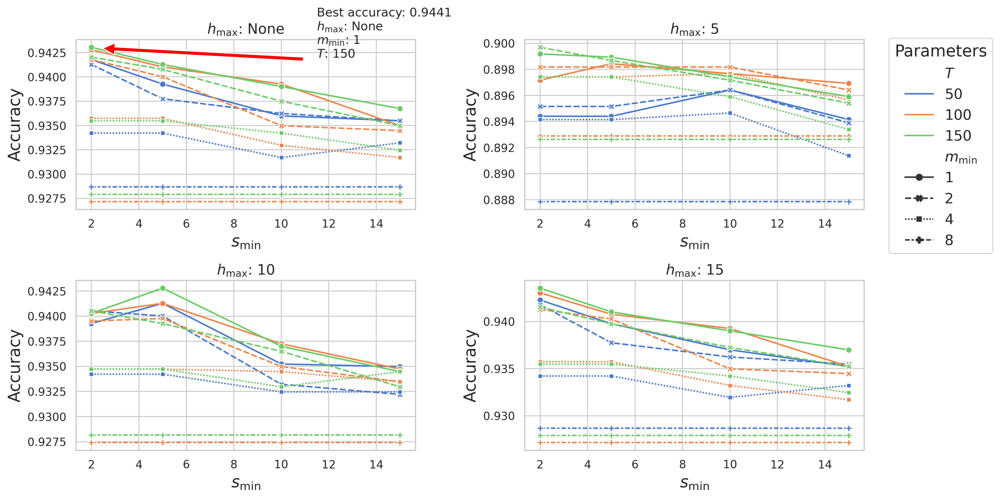

In [246]:
sns.set(style='whitegrid', font_scale=1)
param_grid['max_depth'] = ['None' if x == None else x for x in param_grid['max_depth']]



# print type of param_grid['max_depth']
# plot subplots for each number of neighbors a plot and then all other params in the same plot
fig, axs = plt.subplots(2, 2, figsize=(14, 7), sharey=False, dpi=300, constrained_layout=True)
axs = axs.flatten()
for i, max_depth in enumerate(param_grid['max_depth']):
    if max_depth == None:
        max_depth = 'None'
    sns.lineplot(data=results_df[results_df['max_depth'] == max_depth], 
                x = 'min_samples_split', 
                y='accuracy', 
                style='min_samples_leaf',
                hue='n_estimators', 
                markers=True, 
                ax=axs[i],
                palette='muted',
                )
    

    axs[i].set_title(r'$h_{\max}$' + f': {max_depth}', fontsize=14, )
    axs[i].set_xlabel(r'$s_{\min}$')
    axs[i].set_ylabel('Accuracy')
    # axs[i].legend(title='Parameters', bbox_to_anchor=(1.8, 1.05), loc='upper right', fontsize=14, title_fontsize=16)
    legend = axs[i].legend(title='Parameters', bbox_to_anchor=(1.4, 1.05), loc='upper right', fontsize=14, title_fontsize=16)
    # Replace the "min_samples_leaf" text in the legend with math mode text
    for text in legend.get_texts():
        if text.get_text() == 'min_samples_leaf':
            text.set_text(r'$m_{\min}$')
        if text.get_text() == 'n_estimators':
            text.set_text(r'$T$')
    # print labels of the legend
    # remove legend if it isnt the second plot
    if i != 1:
        axs[i].get_legend().remove()

    # add grid 
    axs[i].grid(True)
    # only keep integers
    axs[i].xaxis.set_major_locator(plt.MaxNLocator(integer=True))
    
    # increase font size of the x and y labels
    axs[i].xaxis.label.set_size(16)
    axs[i].yaxis.label.set_size(16)


best_score = best_score

best_params = grid_search.best_params_
best_n_estimators = best_params['n_estimators']
best_max_depth = best_params['max_depth']
best_min_samples_leaf = best_params['min_samples_leaf']
best_min_samples_split = best_params['min_samples_split']
best_bootstrap = best_params['bootstrap']
# annotate the best point
axs[0].annotate('Best', xy=(best_min_samples_split, best_score), xytext=(best_min_samples_split, best_score + 0.01),
            arrowprops=dict(facecolor='red', shrink=0.05))
axs[0].annotate(
    # 'Min Dist: 0.1\nN Components: 5\nMetric: Euclidean',
    f'Best accuracy: {round(grid_search.best_score_, 4)} \n' + r'$h_{\max}$' + f': {best_max_depth}\n' + r'$m_{\min}$' + f': {best_min_samples_leaf}\n' + r'$T$' + f': {best_n_estimators}',
                xy=(2, 0.943), xytext=(11.5, 0.942),
                arrowprops=dict(facecolor='red', shrink=0.05,
                            # connectionstyle="arc3,rad=.5",
                            # linestyle='dashed'
                )
                            
                            )


plt.tight_layout()
plt.show()

In [65]:
gmm_grid_search

,n_components,covariance_type,tol,reg_covar,bic
0,2,Full,0.0010,0.000001,26573.428475
1,2,Full,0.0010,0.000010,26573.429014
2,2,Full,0.0010,0.000100,26573.437976
3,2,Full,0.0001,0.000001,24394.330533
4,2,Full,0.0001,0.000010,24394.338097
...,...,...,...,...,...
211,10,Spherical,0.0010,0.000010,21144.327083
212,10,Spherical,0.0010,0.000100,21144.381232
213,10,Spherical,0.0001,0.000001,21141.227757
214,10,Spherical,0.0001,0.000010,21141.229426


In [247]:

# Perform parallel grid search using joblib
results = joblib.Parallel(n_jobs=-1)(
    joblib.delayed(evaluate_gmm)(params) for params in tqdm(param_combinations, total=total_iterations)
)

# Collect the results
# for bic_value, param_set in results:
#     bic.append(bic_value)
#     params.append(param_set)


# # Convert lists to numpy arrays for easier indexing
# bic = np.array(bic)
# params = np.array(params)

# # Find the best parameters
# best_index = np.argmin(bic)
# best_params = params[best_index]
# best_bic = bic[best_index]

# best_params_dic = {
#     'n_components': best_params[0],
#     'covariance_type': best_params[1],
#     'tol': best_params[2],
#     'reg_covar': best_params[3],
#     # 'max_iter': best_params[4],
#     # 'n_init': best_params[5],
#     # 'init_params': best_params[6]
# }
# print("Best parameters:", best_params_dic)
# # create a dataframe
# gmm_grid_search = pd.DataFrame(params, columns=['n_components', 'covariance_type', 'tol', 'reg_covar'])#, 'max_iter', 'n_init', 'init_params'
# gmm_grid_search['bic'] = bic
# # convert floats and int
# gmm_grid_search['n_components'] = gmm_grid_search['n_components'].astype(int)
# gmm_grid_search['bic'] = gmm_grid_search['bic'].astype(float)
# gmm_grid_search['tol'] = gmm_grid_search['tol'].astype(float)
# gmm_grid_search['reg_covar'] = gmm_grid_search['reg_covar'].astype(float)
# gmm_grid_search['bic'] = gmm_grid_search['bic'].astype(float)
# # convert each element in best_params_dic to the same types
# best_params_dic = {k: type(v)(best_params_dic[k]) for k, v in best_params_dic.items()}
# # $ make the covariance type capitalized
# gmm_grid_search['covariance_type'] = gmm_grid_search['covariance_type'].str.capitalize()
# # convert diag to Diagonal
# gmm_grid_search['covariance_type'] = gmm_grid_search['covariance_type'].str.replace('diag', 'Diagonal')
# gmm_grid_search






# # plot one plot with the style ebiug the covariance type and the hue being the number of components
# fig, ax = plt.subplots(figsize=(10, 5), dpi=100)
# sns.lineplot(data=gmm_grid_search, x='n_components', y='bic', hue='covariance_type', style='covariance_type', markers=True, dashes=False, palette='muted', ax=ax)
# # ax.set_title('BIC vs Number of Components')
# ax.set_xlabel('Number of Components')
# ax.set_ylabel('BIC')
# ax.legend(title='Covariance Type', bbox_to_anchor=(1.05, 1), loc='upper left')
# # add grid 
# ax.grid(True)
# # add a dashed red line to show the best point
# # ax.axvline(x=best_params_dic['n_components'], color='red', linestyle='--')
# best_bic = gmm_grid_search.bic.min()
# ax.axhline(y=best_bic, color='red', linestyle='--')
# # add arrow pointing towards the best point and saying the bic value
# # y log set
# ax.annotate(f'Best BIC: {round(best_bic,1)}\nComponents: {best_params_dic["n_components"]}\nCovariance Type: {best_params_dic["covariance_type"]}',
#             xy=(9, best_bic), xytext=(11, best_bic + 8000),
#             arrowprops=dict(facecolor='red', shrink=0.01))

100%|██████████| 216/216 [00:00<00:00, 4098.82it/s]


              precision    recall  f1-score   support

           1       0.93      0.98      0.96        44
           2       0.89      1.00      0.94        47
           3       0.92      0.95      0.93        80
           4       0.89      0.94      0.91        17
           5       0.89      0.71      0.79        35
           6       0.95      0.96      0.95       131
           7       1.00      0.93      0.97        15
           8       0.98      0.91      0.94        99
           9       0.97      1.00      0.98        28

    accuracy                           0.94       496
   macro avg       0.93      0.93      0.93       496
weighted avg       0.94      0.94      0.94       496



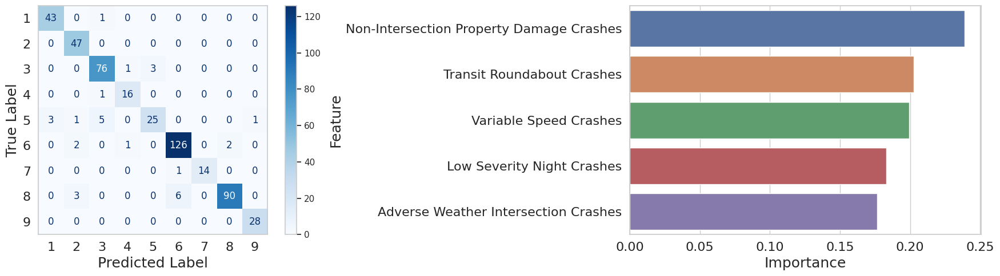

In [248]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import plot_confusion_matrix, ConfusionMatrixDisplay





# Confusion matrix
fig, ax = plt.subplots(1, 2, figsize=(18, 5), dpi=100)

# print the classification_report
print(classification_report(y_test, y_pred))

# Plot confusion matrix
ConfusionMatrixDisplay.from_estimator(best_rf_model, X_test, y_test, cmap=plt.cm.Blues, ax=ax[0])
# ax[0].set_title('Confusion Matrix', fontsize=22)
ax[0].set_xlabel('Predicted Label', fontsize=18)
ax[0].set_ylabel('True Label', fontsize=18)
# increate the font size of the ticks
ax[0].tick_params(axis='both', which='major', labelsize=16)
# remove grid
ax[0].grid(False)

# Plot feature importances
importances = best_rf_model.feature_importances_



indices = np.argsort(importances)[::-1]
features = X.columns
# rename the features to (columns={
#     'UMAP1': 'Low Severity Night Crashes',
#     'UMAP2': 'Non-Intersection Property Damage Crashes',
#     'UMAP3': 'Transit Roundabout Crashes',
#     'UMAP4': 'Adverse Weather Intersection Crashes',
#     'UMAP5': 'Variable Speed Crashes'
# })
features = ['Low Severity Night Crashes', 'Non-Intersection Property Damage Crashes', 'Transit Roundabout Crashes', 'Adverse Weather Intersection Crashes', 'Variable Speed Crashes']


sns.barplot(x=importances[indices], y=[features[i] for i in indices], ax=ax[1])
# ax[1].set_title('Feature Importances', fontsize=22)
ax[1].set_xlabel('Importance', fontsize=18)
ax[1].set_ylabel('Feature', fontsize=18)
# increate the font size of the ticks
ax[1].tick_params(axis='both', which='major', labelsize=16)


plt.tight_layout()
plt.show()




              precision    recall  f1-score   support

           1       0.93      0.98      0.96        44
           2       0.89      1.00      0.94        47
           3       0.92      0.95      0.93        80
           4       0.89      0.94      0.91        17
           5       0.89      0.71      0.79        35
           6       0.95      0.96      0.95       131
           7       1.00      0.93      0.97        15
           8       0.98      0.91      0.94        99
           9       0.97      1.00      0.98        28

    accuracy                           0.94       496
   macro avg       0.93      0.93      0.93       496
weighted avg       0.94      0.94      0.94       496



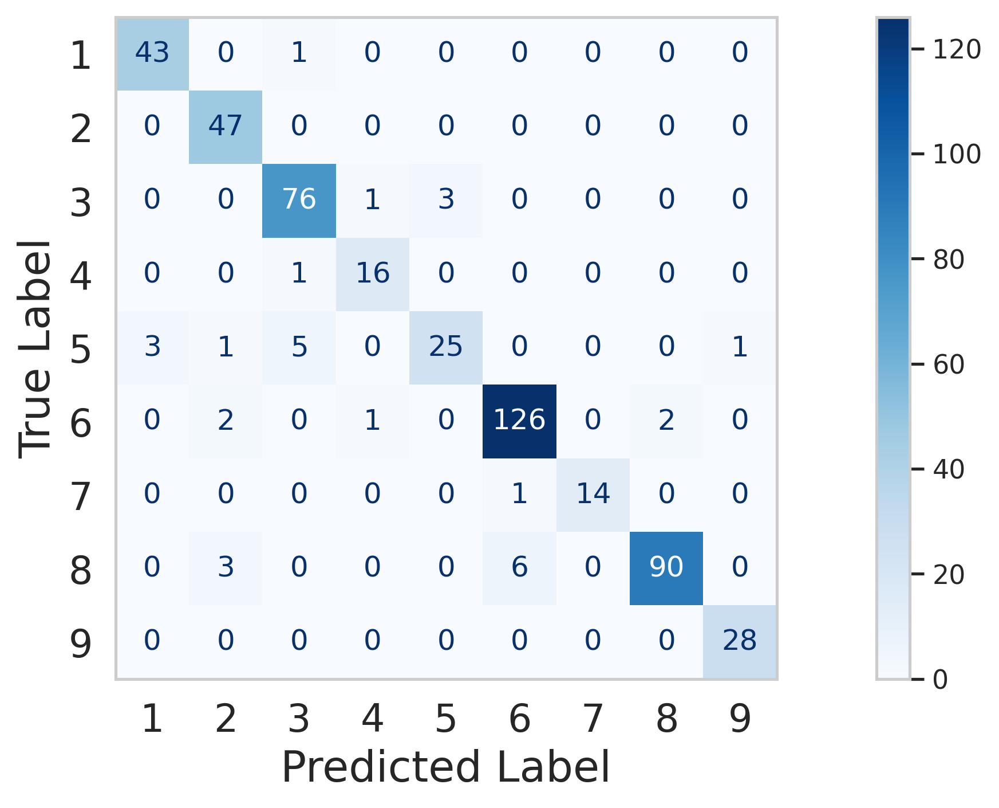

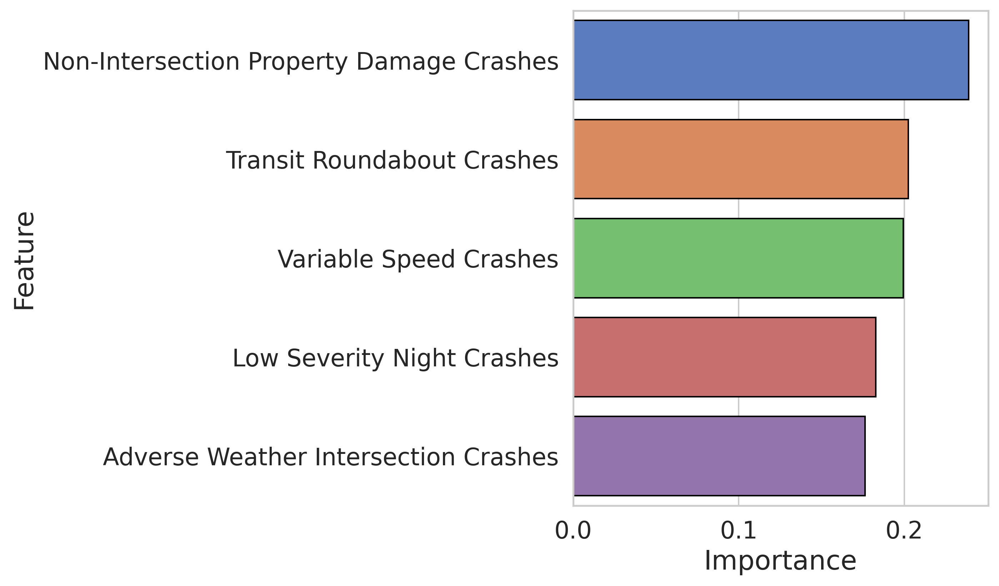

In [250]:

import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import plot_confusion_matrix, ConfusionMatrixDisplay





# Confusion matrix
fig, ax = plt.subplots(1, 1, figsize=(15, 5), dpi=300)

# print the classification_report
print(classification_report(y_test, y_pred))

# Plot confusion matrix
ConfusionMatrixDisplay.from_estimator(best_rf_model, X_test, y_test, cmap=plt.cm.Blues, ax=ax)
# ax.set_title('Confusion Matrix', fontsize=22)
ax.set_xlabel('Predicted Label', fontsize=18)
ax.set_ylabel('True Label', fontsize=18)
# increate the font size of the ticks
ax.tick_params(axis='both', which='major', labelsize=16)
# remove grid
ax.grid(False)

# Plot feature importances
importances = best_rf_model.feature_importances_



indices = np.argsort(importances)[::-1]
features = X.columns
# rename the features to (columns={
#     'UMAP1': 'Low Severity Night Crashes',
#     'UMAP2': 'Non-Intersection Property Damage Crashes',
#     'UMAP3': 'Transit Roundabout Crashes',
#     'UMAP4': 'Adverse Weather Intersection Crashes',
#     'UMAP5': 'Variable Speed Crashes'
# })
features = ['Low Severity Night Crashes', 'Non-Intersection Property Damage Crashes', 'Transit Roundabout Crashes', 'Adverse Weather Intersection Crashes', 'Variable Speed Crashes']

# Confusion matrix
fig, ax = plt.subplots(1, 1, figsize=(5, 6), dpi=300)
sns.barplot(x=importances[indices], y=[features[i] for i in indices], ax=ax, palette='muted', edgecolor='black', linewidth=1)
# ax.set_title('Feature Importances', fontsize=22)
ax.set_xlabel('Importance', fontsize=18)
ax.set_ylabel('Feature', fontsize=18)
# increate the font size of the ticks
ax.tick_params(axis='both', which='major', labelsize=16)


# plt.tight_layout()
plt.show()


TypeError: cannot unpack non-iterable NoneType object

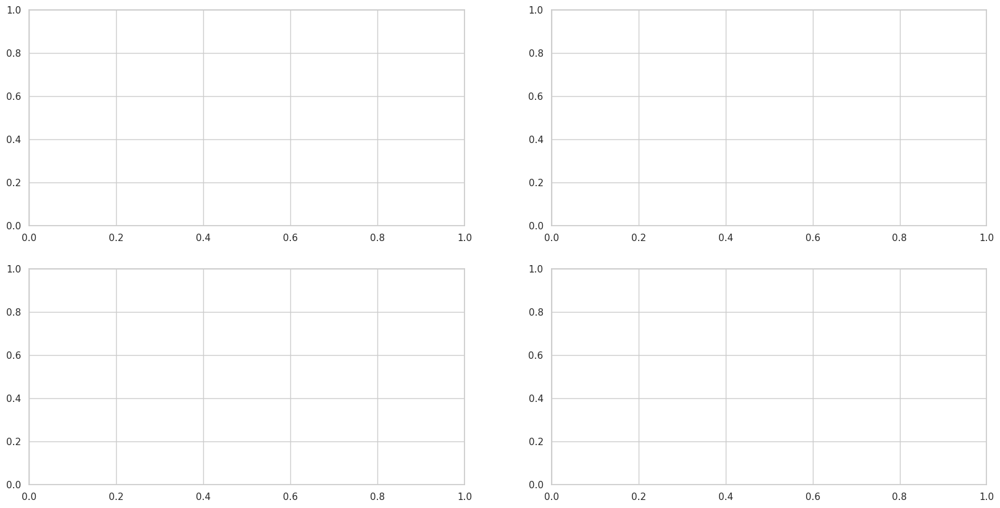

In [69]:

# Grid search results
results = grid_search.cv_results_
param_grid = grid_search.param_grid


 # Convert the grid search results to a DataFrame
results_df = pd.DataFrame(grid_search.cv_results_)

# Select relevant columns for plotting
columns_to_keep = ['param_max_depth', 'param_n_estimators', 'param_min_samples_split', 'param_min_samples_leaf', 'param_bootstrap', 'mean_test_score']
results_df = results_df[columns_to_keep]

# Rename columns for clarity
results_df.columns = ['max_depth', 'n_estimators', 'min_samples_split', 'min_samples_leaf', 'bootstrap', 'mean_test_score']


fig, axs = plt.subplots(2, 2, figsize=(20, 10), dpi=100)
axs = axs.flatten()

# Plot the results for each max_depth in results_df
for i, max_depth in results_df['max_depth'].unique():
    sns.scatterplot(data=results_df[results_df['max_depth'] == max_depth], 
                    x='n_estimators', 
                    y='mean_test_score', 
                    hue='n_estimators', 
                    style='bootstrap', 
                    palette='muted', 
                    markers=True,
        legend='full',
        alpha=0.9,
        edgecolor='black',
        linewidth=0.5
    )
    axs[i].set_title(f'Max Depth: {max_depth}')
    axs[i].set_xlabel('Parameter Set Index')
    axs[i].set_ylabel('Mean Test Score')
    legend1 = axs[i].legend(*scatter.legend_elements(), title="n_estimators")
    axs[i].add_artist(legend1)


plt.tight_layout()
plt.show()



In [ ]:
importances

array([0.18287284, 0.23879936, 0.20247541, 0.17641288, 0.19943952])

[[ 55   0   1   0   1   0   1   2   0]
 [  0  30   5   0   0  38   0  15   0]
 [  2   0 130   0   2   0   0   0   1]
 [  1   2   4  11   1   4   0   1   0]
 [  9   0  22   0  14   2   0   6   1]
 [  0   2   0   2   0 154   0  24   0]
 [  3   4   0   0   0  10   6   3   0]
 [  0   2   3   0   0  18   0 112   0]
 [  4   1   9   2   0   6   0  12   6]]
              precision    recall  f1-score   support

           1       0.74      0.92      0.82        60
           2       0.73      0.34      0.47        88
           3       0.75      0.96      0.84       135
           4       0.73      0.46      0.56        24
           5       0.78      0.26      0.39        54
           6       0.66      0.85      0.74       182
           7       0.86      0.23      0.36        26
           8       0.64      0.83      0.72       135
           9       0.75      0.15      0.25        40

    accuracy                           0.70       744
   macro avg       0.74      0.55      0.57       74

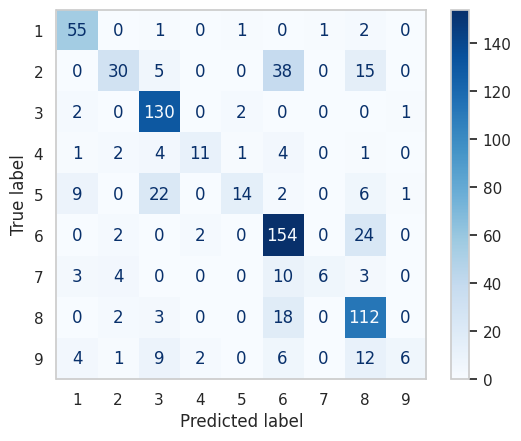

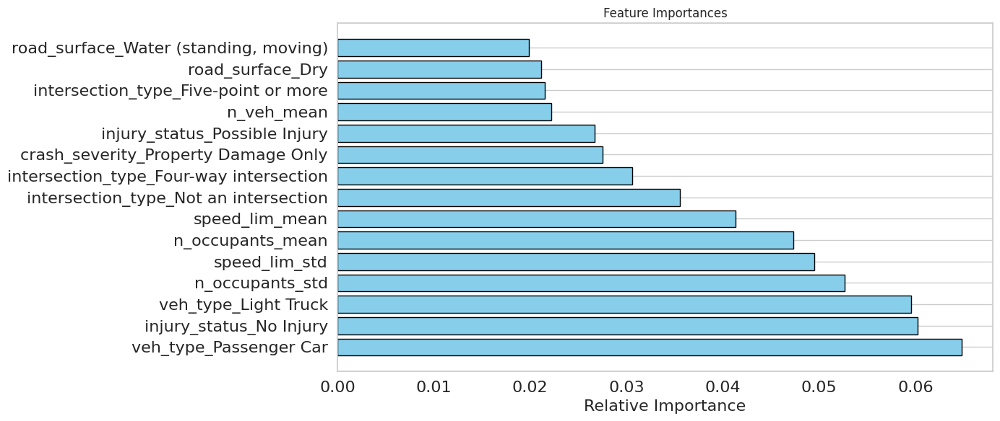

In [ ]:
from sklearn.model_selection import train_test_split

# Define features and target
X = df.drop(columns=['census_tract_id', 'GMM Cluster', 'UMAP1', 'UMAP2', 'UMAP3', 'UMAP4', 'UMAP5'])
# JUST MAKE IT THE umaps
# X = df[['UMAP1', 'UMAP2', 'UMAP3', 'UMAP4', 'UMAP5']]
y = df['GMM Cluster']

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)


from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix

# Train Random Forest model
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Predict on test set
y_pred = rf_model.predict(X_test)

# Evaluate model performance
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

# Plot confusion matrix
import seaborn as sns
from sklearn.metrics import ConfusionMatrixDisplay

ConfusionMatrixDisplay.from_estimator(rf_model, X_test, y_test, cmap='Blues')
plt.grid(False)
plt.show()

# Feature importance plot
importances = rf_model.feature_importances_
# getonly the top 10 features
indices = np.argsort(importances)[::-1][:15]


plt.figure(figsize=(14, 6))
plt.title('Feature Importances')
# plot barh of the top 10 features
plt.barh(range(15), importances[indices], align='center', color='skyblue', edgecolor='black', linewidth=1)
plt.yticks(range(15), [X.columns[i] for i in indices], fontsize=16)
plt.xticks(fontsize=16)
plt.xlabel('Relative Importance', fontsize=16)
# remove grid
plt.grid(axis='x')
plt.tight_layout()
plt.show()


# Now let 

In [ ]:
df

,census_tract_id,crash_severity_Property Damage Only,"crash_severity_Injury of any type (Serious, Minor, Possible)",crash_severity_Fatal,injury_status_No Injury,injury_status_Possible Injury,injury_status_Minor Injury,injury_status_Serious Injury,injury_status_Fatal Injury,road_surface_Dry,...,road_surface_Slush,intersection_type_roundabout,"road_surface_Water (standing, moving)",road_surface_Other,UMAP1,UMAP2,UMAP3,UMAP4,UMAP5,GMM Cluster
0,9110400101,0.725038,0.271889,0.003072,0.855607,0.090630,0.041475,0.004608,0.001536,0.846390,...,0.000000,0.0,0.000000,0.0,5.324759,8.739054,7.277343,6.073350,7.673935,3
1,9110400102,0.766478,0.225989,0.007533,0.841808,0.082863,0.052731,0.001883,0.003766,0.830508,...,0.000000,0.0,0.000000,0.0,5.385496,8.643008,6.564764,7.135562,7.912130,1
2,9110400200,0.467890,0.525994,0.006116,0.697248,0.186544,0.100917,0.003058,0.003058,0.700306,...,0.009174,0.0,0.000000,0.0,5.695424,9.068827,7.801274,6.074081,7.306258,3
3,9110400300,0.679842,0.320158,0.000000,0.766798,0.130435,0.067194,0.007905,0.000000,0.747036,...,0.007905,0.0,0.000000,0.0,4.426844,7.779685,6.476120,7.500033,7.883718,1
4,9110415300,0.610526,0.389474,0.000000,0.747368,0.084211,0.126316,0.000000,0.000000,0.736842,...,0.000000,0.0,0.000000,0.0,5.240202,7.915087,7.308212,6.623810,7.991474,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2475,25027761401,0.777174,0.195652,0.000000,0.228261,0.010870,0.016304,0.005435,0.000000,0.755435,...,0.005435,0.0,0.005435,0.0,8.570038,12.185274,9.388142,7.369834,6.160703,6
2476,25027761402,0.763359,0.213740,0.000000,0.244275,0.000000,0.015267,0.000000,0.000000,0.793893,...,0.000000,0.0,0.000000,0.0,8.558337,12.208297,9.396056,7.418632,6.138029,6
2477,44005041701,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,...,0.000000,0.0,0.000000,0.0,7.022885,11.253852,9.546098,6.475631,6.502968,7
2478,44005041702,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,...,0.000000,0.0,0.000000,0.0,6.799222,11.129443,10.259074,7.957565,5.362234,2


In [ ]:
# from sklearn.linear_model import LinearRegression

# # Train a linear regression model to predict original features from UMAP components
# reconstruction_errors = []
# for col in original_df.columns:
#     model = LinearRegression()
#     model.fit(umap_df, original_df[col])
#     predicted = model.predict(umap_df)
#     error = np.mean((predicted - original_df[col]) ** 2)
#     reconstruction_errors.append(error)

# # Map errors to original features
# reconstruction_df = pd.DataFrame({
#     'Feature': original_df.columns,
#     'Reconstruction_Error': reconstruction_errors
# }).sort_values(by='Reconstruction_Error')

# # Plot reconstruction errors
# plt.figure(figsize=(12, 8))
# sns.barplot(data=reconstruction_df, x='Feature', y='Reconstruction_Error', palette='viridis')
# plt.title('Reconstruction Error of Original Features from UMAP Components')
# plt.xticks(rotation=90)
# plt.show()



In [ ]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns
# from sklearn.ensemble import RandomForestRegressor

# # Function to train a regression model and get top 5 feature importances
# def get_top_feature_importances(X, y, feature_names, umap_component, top_n=10):
    
#     model = RandomForestRegressor(random_state=0)
#     # use the best model parameters here as well {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 150}
#     # model = RandomForestRegressor(bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=150, random_state=42)
#     model.fit(X, y)
#     importances = model.feature_importances_
#     importance_df = pd.DataFrame({
#         'Feature': feature_names,
#         'Importance': importances
#     }).sort_values(by='Importance', ascending=False).head(top_n)
#     return importance_df, umap_component

# # Calculate top 5 feature importances for each UMAP component
# importance_dfs = []
# # remove veh_type_Passenger Car from the original_df columns
# # original_df = original_df.drop(columns=['veh_type_Passenger Car'])
# # remove any vehicle types
# # original_df = original_df.drop(columns=[col for col in original_df.columns if 'veh_type' in col])
# for umap_component in umap_df.columns:
#     importance_df, component = get_top_feature_importances(original_df, umap_df[umap_component], original_df.columns, umap_component)
#     importance_df['UMAP_Component'] = component
#     importance_dfs.append(importance_df)


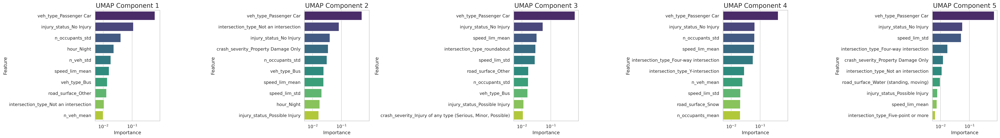

In [ ]:
# # remove veh_type_Passenger Car
# # importance_dfs[0] = importance_dfs[0][importance_dfs[0]['Feature'] != 'veh_type_Passenger Car']
# # importance_dfs[1] = importance_dfs[1][importance_dfs[1]['Feature'] != 'veh_type_Passenger Car']
# # importance_dfs[2] = importance_dfs[2][importance_dfs[2]['Feature'] != 'veh_type_Passenger Car']
# # importance_dfs[3] = importance_dfs[3][importance_dfs[3]['Feature'] != 'veh_type_Passenger Car']
# # importance_dfs[4] = importance_dfs[4][importance_dfs[4]['Feature'] != 'veh_type_Passenger Car']

# # Plot top feature importances for each UMAP component
# fig, axes = plt.subplots(nrows=1, ncols=len(umap_df.columns), figsize=(35, 5), sharey=False, dpi=100, sharex=True)

# for ax, importance_df, umap_component in zip(axes, importance_dfs, umap_df.columns):
#     sns.barplot(data=importance_df, x='Importance', y='Feature', ax=ax, palette='viridis')
#     ax.set_title(f'UMAP Component {umap_component[4]}', fontsize=16)
#     ax.set_xlabel('Importance')
#     ax.set_ylabel('Feature')
#     # set x ticks every 0.05
#     ax.set_xticks([i/20 for i in range(21)])
#     # set x log
#     ax.set_xscale('log')
    


# plt.tight_layout()
# plt.show()

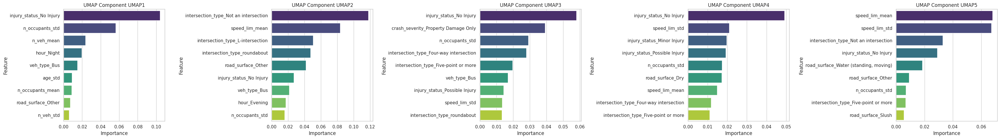

In [ ]:
# # remove veh_type_Passenger Car
# importance_dfs[0] = importance_dfs[0][importance_dfs[0]['Feature'] != 'veh_type_Passenger Car']
# importance_dfs[1] = importance_dfs[1][importance_dfs[1]['Feature'] != 'veh_type_Passenger Car']
# importance_dfs[2] = importance_dfs[2][importance_dfs[2]['Feature'] != 'veh_type_Passenger Car']
# importance_dfs[3] = importance_dfs[3][importance_dfs[3]['Feature'] != 'veh_type_Passenger Car']
# importance_dfs[4] = importance_dfs[4][importance_dfs[4]['Feature'] != 'veh_type_Passenger Car']

# # Plot top feature importances for each UMAP component
# fig, axes = plt.subplots(nrows=1, ncols=len(umap_df.columns), figsize=(35, 5), sharey=False)

# for ax, importance_df, umap_component in zip(axes, importance_dfs, umap_df.columns):
#     sns.barplot(data=importance_df, x='Importance', y='Feature', ax=ax, palette='viridis')
#     ax.set_title(f'UMAP Component {umap_component}')
#     ax.set_xlabel('Importance')
#     ax.set_ylabel('Feature')

# plt.tight_layout()
# plt.show()
